In [1]:
# general purpose python
import collections
import datetime
import glob
import importlib
import itertools
import json
import math
import os
import pickle
import random
import re
import shutil
import sys
import time
import warnings

# general purpose data science
import IPython
import ipywidgets as ipw
import matplotlib as mpl
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import plotly
import plotly.express as px
import plotly.graph_objects as go
from plotly.offline import download_plotlyjs
import pylab
import scipy
import seaborn as sns
import sklearn
from sklearn import *
import statsmodels as sm

# computer vision
import cv2
import imageio
import PIL
from PIL import *

# deep learning
import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
import torchvision
device = torch.device('cuda') if torch.cuda.is_available() else torch.device('cpu')
print('pytorch device:    ', device.type)

# geospatial
import rasterio as rio
import rasterio.features

ignore_warnings = True
if ignore_warnings:
    warnings.filterwarnings('ignore')
print('ignore warnings:   ', ignore_warnings)

seed = 1337
np.random.seed(seed)
torch.manual_seed(seed)
print('random seed:       ', seed)

mpl.rcParams['figure.dpi'] = 200

IPython.core.display.display(IPython.core.display.HTML("<style>.container { width:100% !important; }</style>"))

pd.options.display.max_colwidth = 32
pd.options.display.float_format = '{:,.6f}'.format
pd.options.display.expand_frame_repr = False

%matplotlib inline

sns.set(font_scale=1.3)
sns.set_style('whitegrid')
sns.set_palette(sns.color_palette('muted'))

plotly.offline.init_notebook_mode(connected=True)
plotly.io.templates.default = 'plotly_white'

_ = torch.autograd.set_detect_anomaly(True)

pytorch device:     cuda
ignore warnings:    True
random seed:        1337


### Load the data

In [2]:
def get_data_loader(image_size, batch_size):
    img_transform = torchvision.transforms.Compose([
        torchvision.transforms.Resize(image_size),
        torchvision.transforms.CenterCrop(image_size),
        torchvision.transforms.ToTensor(),
        torchvision.transforms.Normalize((0.5, 0.5, 0.5),
                                         (0.5, 0.5, 0.5))])
    celeb_dataset = torchvision.datasets.ImageFolder(root='../data/celeba/',
                                                     transform=img_transform)
    data_loader = torch.utils.data.DataLoader(celeb_dataset,
                                              batch_size=batch_size,
                                              shuffle=True)
    return data_loader

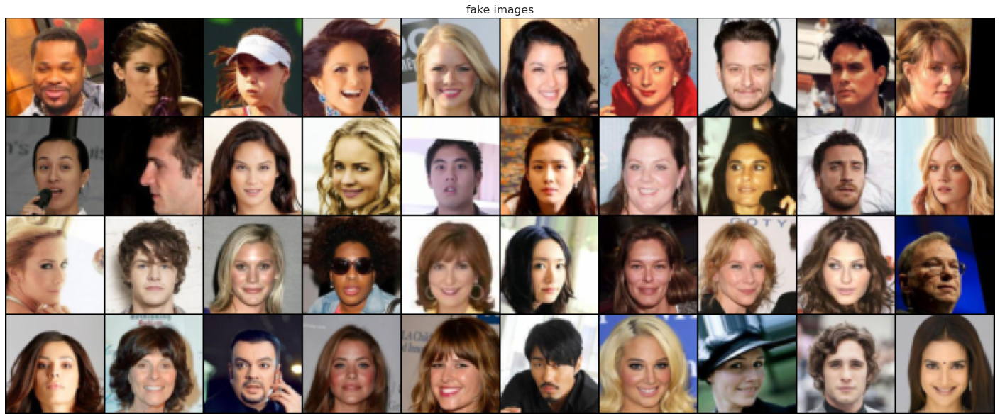

In [3]:
# take a look at some samples
data_loader = get_data_loader(2**6, 2**7)
batch = next(iter(data_loader))
plt.figure(figsize=(25,25))
plt.imshow(np.transpose(torchvision.utils.make_grid(batch[0][:40],
                                                    nrow=10,
                                                    padding=1,
                                                    normalize=True).cpu(),(1,2,0)))
plt.axis('off')
plt.title(f'fake images')
plt.show()

### Define the model

In [4]:
# init model weights according to some papers
def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)


# adds noise to encoder inputs
class AddNoiseTransform():
    def __init__(self, mean=0.0, std=1.0):
        self.std = std
        self.mean = mean
        
    def __call__(self, x):
        return x + (self.mean + self.std * torch.randn(x.shape).to(device))

    
# reshape node to unflatten input going from a dense layer to a conv transpose layer
class Reshape(nn.Module):
    def __init__(self, *args):
        super(Reshape, self).__init__()
        self.shape = args

    def forward(self, x):
        return x.view(self.shape)


# add noise to the layers inside the decoder that has zero mean and a variable std
class AddNoise(nn.Module):
    def __init__(self, layer_noise_std_multiplier):
        super(AddNoise, self).__init__()
        self.layer_noise_std_multiplier = layer_noise_std_multiplier

    def forward(self, x):
        return x + torch.randn(x.shape).to(device) * torch.std(x) * self.layer_noise_std_multiplier


class AutoEncoder(nn.Module):
    def __init__(self,
                 n_code_dim=32,
                 n_channels=3,
                 relu_slope=0.01,
                 bias=False,
                 n_encoder_feature_maps=16,
                 encoder_feature_map_multiplier=1,
                 n_encoder_dense_layers=0,
                 encoder_dense_neurons_multiplier=2,
                 encoder_dropout=0.0,
                 input_noise_p=0.0,
                 input_noise_std=0.0,
                 n_decoder_feature_maps=16,
                 decoder_feature_map_multiplier=1,
                 n_decoder_dense_layers=0,
                 decoder_dense_neurons_multiplier=2,
                 decoder_dropout=0.0,
                 layer_noise_std_multiplier=0.0):
        super(AutoEncoder, self).__init__()
        
        self.n_code_dim = n_code_dim
        self.n_channels = n_channels
        self.relu_slope = relu_slope
        self.bias = bias
        self.n_encoder_feature_maps = n_encoder_feature_maps
        self.encoder_feature_map_multiplier = encoder_feature_map_multiplier
        self.n_encoder_dense_layers = n_encoder_dense_layers
        self.encoder_dense_neurons_multiplier = encoder_dense_neurons_multiplier
        self.encoder_dropout = encoder_dropout
        self.input_noise_p = input_noise_p
        self.input_noise_std = input_noise_std
        self.n_decoder_feature_maps = n_decoder_feature_maps
        self.decoder_feature_map_multiplier = decoder_feature_map_multiplier
        self.n_decoder_dense_layers = n_decoder_dense_layers
        self.decoder_dense_neurons_multiplier = decoder_dense_neurons_multiplier
        self.decoder_dropout = decoder_dropout
        self.layer_noise_std_multiplier = layer_noise_std_multiplier
        
        self.input_transform = torchvision.transforms.Compose([
            torchvision.transforms.RandomApply([AddNoiseTransform(mean=0.0, std=self.input_noise_std)], p=self.input_noise_p)])
        
        encoder_modules = [
            nn.Conv2d(in_channels=self.n_channels,
                      out_channels=self.n_encoder_feature_maps,
                      kernel_size=4,
                      stride=2,
                      padding=1,
                      bias=self.bias),
            nn.BatchNorm2d(num_features=self.n_encoder_feature_maps),
            nn.Dropout(self.encoder_dropout),
            nn.LeakyReLU(negative_slope=self.relu_slope,
                         inplace=True)]
        
        n_fm = self.n_encoder_feature_maps
        for i in range(3):
            encoder_modules.append(nn.Conv2d(in_channels=n_fm,
                                             out_channels=n_fm * self.encoder_feature_map_multiplier,
                                             kernel_size=4,
                                             stride=2,
                                             padding=1,
                                             bias=self.bias))
            encoder_modules.append(nn.BatchNorm2d(num_features=n_fm * self.encoder_feature_map_multiplier))
            encoder_modules.append(nn.Dropout(self.encoder_dropout))
            encoder_modules.append(nn.LeakyReLU(negative_slope=self.relu_slope,
                                                inplace=True))
            n_fm *= self.encoder_feature_map_multiplier

        encoder_modules.append(nn.Conv2d(in_channels=n_fm,
                                         out_channels=n_code_dim if self.n_encoder_dense_layers == 0 else self.n_code_dim * self.encoder_dense_neurons_multiplier,
                                         kernel_size=4,
                                         stride=1,
                                         padding=0,
                                         bias=self.bias))
        encoder_modules.append(nn.BatchNorm2d(num_features=n_code_dim if self.n_encoder_dense_layers == 0 else self.n_code_dim * self.encoder_dense_neurons_multiplier))
        
        encoder_modules.append(nn.Flatten())
        
        if self.n_encoder_dense_layers > 0:
            for i in range(self.n_encoder_dense_layers - 1):
                encoder_modules.append(nn.Dropout(self.encoder_dropout))
                encoder_modules.append(nn.LeakyReLU(negative_slope=self.relu_slope,
                                                inplace=True))
                encoder_modules.append(nn.Linear(in_features=self.n_code_dim * self.encoder_dense_neurons_multiplier,
                                                 out_features=self.n_code_dim * self.encoder_dense_neurons_multiplier,
                                                 bias=self.bias))
            
            encoder_modules.append(nn.Dropout(self.encoder_dropout))
            encoder_modules.append(nn.LeakyReLU(negative_slope=self.relu_slope,
                                                inplace=True))
            encoder_modules.append(nn.Linear(in_features=self.n_code_dim * self.encoder_dense_neurons_multiplier,
                                             out_features=self.n_code_dim,
                                             bias=self.bias))
        
        encoder_modules.append(nn.Dropout(self.encoder_dropout))
        encoder_modules.append(nn.Sigmoid())
        
        encoder_modules = collections.OrderedDict(zip([f'layer_{i:03d}' for i in range(len(encoder_modules))], encoder_modules))
        self.encoder = nn.Sequential(encoder_modules)
        weights_init(self.encoder)
        
        decoder_modules = []
        if n_decoder_dense_layers > 0:
            decoder_modules.append(nn.Linear(in_features=self.n_code_dim,
                                             out_features=self.n_code_dim * self.decoder_dense_neurons_multiplier,
                                             bias=self.bias))
            decoder_modules.append(AddNoise(self.layer_noise_std_multiplier))
            decoder_modules.append(nn.Dropout(self.decoder_dropout))
            decoder_modules.append(nn.LeakyReLU(negative_slope=self.relu_slope,
                                                inplace=True))
            
            for i in range(self.n_decoder_dense_layers - 1):
                decoder_modules.append(nn.Linear(in_features=self.n_code_dim * self.decoder_dense_neurons_multiplier,
                                                 out_features=self.n_code_dim * self.decoder_dense_neurons_multiplier,
                                                 bias=self.bias))
                decoder_modules.append(AddNoise(self.layer_noise_std_multiplier))
                decoder_modules.append(nn.Dropout(self.decoder_dropout))
                decoder_modules.append(nn.LeakyReLU(negative_slope=self.relu_slope,
                                                inplace=True))

        decoder_modules.append(Reshape(-1, self.n_code_dim if self.n_decoder_dense_layers == 0 else self.n_code_dim * self.decoder_dense_neurons_multiplier, 1, 1))
        
        n_fm = self.n_decoder_feature_maps * self.decoder_feature_map_multiplier**3
        decoder_modules.append(nn.ConvTranspose2d(in_channels=self.n_code_dim if self.n_decoder_dense_layers == 0 else self.n_code_dim * self.decoder_dense_neurons_multiplier,
                                                  out_channels=n_fm,
                                                  kernel_size=4,
                                                  stride=1,
                                                  padding=0,
                                                  bias=False))
        decoder_modules.append(AddNoise(self.layer_noise_std_multiplier))
        decoder_modules.append(nn.BatchNorm2d(num_features=n_fm))
        decoder_modules.append(nn.Dropout(self.decoder_dropout))
        decoder_modules.append(nn.LeakyReLU(negative_slope=self.relu_slope,
                                            inplace=True))
        
        for i in range(3):
            n_fm = int(n_fm / self.decoder_feature_map_multiplier)
            decoder_modules.append(nn.ConvTranspose2d(in_channels=n_fm * self.decoder_feature_map_multiplier,
                                                      out_channels=n_fm,
                                                      kernel_size=4,
                                                      stride=2,
                                                      padding=1,
                                                      bias=self.bias))
            decoder_modules.append(AddNoise(self.layer_noise_std_multiplier))
            decoder_modules.append(nn.BatchNorm2d(num_features=n_fm))
            decoder_modules.append(nn.Dropout(self.decoder_dropout))
            decoder_modules.append(nn.LeakyReLU(negative_slope=self.relu_slope,
                                                inplace=True))

        decoder_modules.append(nn.ConvTranspose2d(in_channels=n_fm,
                                              out_channels=self.n_channels,
                                              kernel_size=4,
                                              stride=2,
                                              padding=1,
                                              bias=False))
        decoder_modules.append(nn.BatchNorm2d(num_features=self.n_channels))
        decoder_modules.append(nn.Dropout(self.decoder_dropout))
        
        decoder_modules.append(nn.Tanh())
        
        decoder_modules = collections.OrderedDict(zip([f'layer_{i:03d}' for i in range(len(decoder_modules))], decoder_modules))
        self.decoder = nn.Sequential(decoder_modules)
        weights_init(self.decoder)

    def forward(self, x):
        x_transformed = self.input_transform(x)
        z = self.encoder(x_transformed)
        y = self.decoder(z)
        return y
    
    def get_hyperparams(self):
        hyperparams = collections.OrderedDict()
        hyperparams['n_code_dim'] = self.n_code_dim
        hyperparams['n_channels'] = self.n_channels
        hyperparams['relu_slope'] = self.relu_slope
        hyperparams['bias'] = self.bias
        hyperparams['n_encoder_feature_maps'] = self.n_encoder_feature_maps
        hyperparams['encoder_feature_map_multiplier'] = self.encoder_feature_map_multiplier
        hyperparams['n_encoder_dense_layers'] = self.n_encoder_dense_layers
        hyperparams['encoder_dense_neurons_multiplier'] = self.encoder_dense_neurons_multiplier
        hyperparams['encoder_dropout'] = self.encoder_dropout
        hyperparams['input_noise_p'] = self.input_noise_p
        hyperparams['input_noise_std'] = self.input_noise_std
        hyperparams['n_decoder_feature_maps'] = self.n_decoder_feature_maps
        hyperparams['decoder_feature_map_multiplier'] = self.decoder_feature_map_multiplier
        hyperparams['n_decoder_dense_layers'] = self.n_decoder_dense_layers
        hyperparams['decoder_dense_neurons_multiplier'] = self.decoder_dense_neurons_multiplier
        hyperparams['decoder_dropout'] = self.decoder_dropout
        hyperparams['layer_noise_std_multiplier'] = self.layer_noise_std_multiplier
        return hyperparams


# create an instance
ae = AutoEncoder(n_decoder_dense_layers=2,
                 n_encoder_dense_layers=2).to(device)
print(ae)
print(ae.get_hyperparams())

# make sure that the input/output sizes are correct
x = torch.rand(128 * 3 * 64 * 64).view(128, 3, 64, 64).to(device)
print('input shape:  ', x.shape)
y = ae.forward(x)
print('output shape: ', y.shape)

AutoEncoder(
  (encoder): Sequential(
    (layer_000): Conv2d(3, 16, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (layer_001): BatchNorm2d(16, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (layer_002): Dropout(p=0.0, inplace=False)
    (layer_003): LeakyReLU(negative_slope=0.01, inplace=True)
    (layer_004): Conv2d(16, 16, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (layer_005): BatchNorm2d(16, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (layer_006): Dropout(p=0.0, inplace=False)
    (layer_007): LeakyReLU(negative_slope=0.01, inplace=True)
    (layer_008): Conv2d(16, 16, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (layer_009): BatchNorm2d(16, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (layer_010): Dropout(p=0.0, inplace=False)
    (layer_011): LeakyReLU(negative_slope=0.01, inplace=True)
    (layer_012): Conv2d(16, 16, kernel_size=(4, 4), stride=(

In [5]:
performances = []

In [6]:
import hashlib

In [7]:
def evaluate_model(model):
    n_epochs = 4
    learning_rate = 1e-4
    weight_decay = 1e-5
    beta1 = 0.5

    criterion = nn.MSELoss()
    optimizer = torch.optim.Adam(
        model.parameters(),
        lr=learning_rate,
        weight_decay=weight_decay,
        betas=(beta1, 0.999))

    losses = []
    start_ts = datetime.datetime.now()
    for epoch in range(1, n_epochs + 1):
        for i, data in enumerate(data_loader, 0):
            optimizer.zero_grad()
            x, _ = data
            x = x.to(device)
            y = model(x)
            l = criterion(x, y)
            loss = round(l.data.item(), 4)
            l.backward()
            optimizer.step()

            if i in [int(x) for x in np.linspace(0, len(data_loader) - 1, 10)[1:]]:
                losses.append(loss)

        print('time: {0}{6}epoch: {1:03d}/{2:03d}{6}batch: {3:05d}/{4:05d}{6}loss: {5:0.4f}{6}'.format(
            datetime.datetime.now().strftime('%H:%M:%S'),
            epoch,
            n_epochs,
            i,
            len(data_loader),
            loss,
            '        '))
        
    recent_loss = round(np.mean(losses[-5:]), 4)
    training_time = int((datetime.datetime.now() - start_ts).total_seconds())

    results = model.get_hyperparams()
    results['losses'] = losses
    results['recent_loss'] = recent_loss
    results['training_time'] = training_time
    
    file_name = f'DCAE_effect_of_hyperparams_result_{hashlib.sha1(str(results).encode("utf-8")).hexdigest()[:8]}.json'
    print(file_name)
    with open(file_name, 'w') as f:
        f.write(json.dumps(results))
    
    for k in results.keys():
        print(f'{k:40}', results[k])
    
    plt.figure(figsize=(25, 5))
    x_scale = np.linspace(1, n_epochs, len(losses))
    plt.plot(x_scale,
             losses,
             c='r',
             linewidth=1,
             marker='.')
    plt.xticks(range(0, n_epochs + 1))
    plt.xlim(1, n_epochs)
    plt.ylim(0, None)
    plt.show()

    x, _ = next(iter(data_loader))
    x = x.to(device)
    y = model(x)
    plt.figure(figsize=(25,25))
    plt.imshow(np.transpose(torchvision.utils.make_grid(torch.cat((x[:10].detach(),
                                                                   y[:10].detach(),
                                                                   x[10:20].detach(),
                                                                   y[10:20].detach(),), 0),
                                                        nrow=10,
                                                        padding=1,
                                                        normalize=True).cpu(),(1,2,0)))
    plt.axis('off')
    plt.show()
    
    return results

time: 19:43:53        epoch: 001/004        batch: 01582/01583        loss: 0.0920        
time: 19:47:45        epoch: 002/004        batch: 01582/01583        loss: 0.0851        
time: 19:51:37        epoch: 003/004        batch: 01582/01583        loss: 0.0844        
time: 19:55:29        epoch: 004/004        batch: 01582/01583        loss: 0.0800        
DCAE_effect_of_hyperparams_result_cec91e0a.json
n_code_dim                               16
n_channels                               3
relu_slope                               0.01
bias                                     False
n_encoder_feature_maps                   8
encoder_feature_map_multiplier           2
n_encoder_dense_layers                   0
encoder_dense_neurons_multiplier         4
encoder_dropout                          0.0
input_noise_p                            0.0
input_noise_std                          0.0
n_decoder_feature_maps                   8
decoder_feature_map_multiplier           2
n_decoder_dense

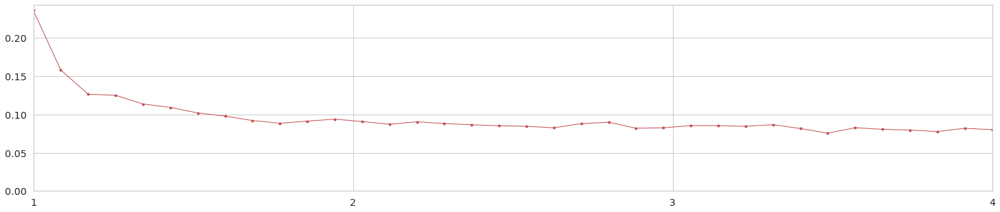

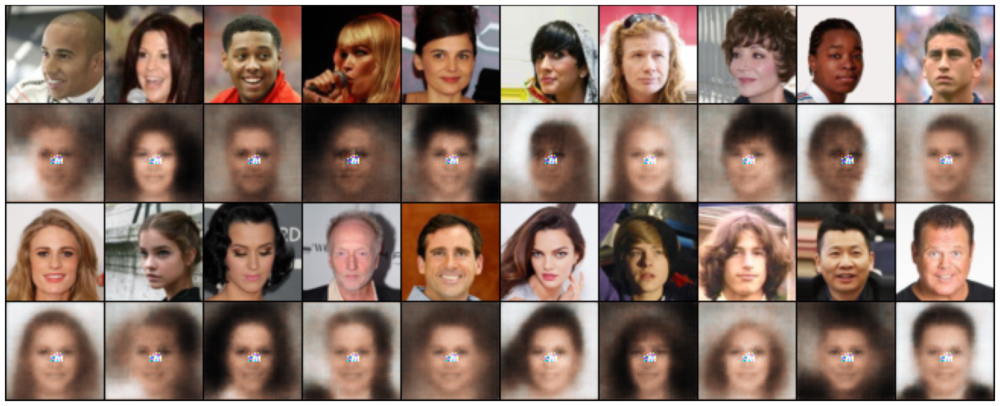

time: 19:59:28        epoch: 001/004        batch: 01582/01583        loss: 0.0993        
time: 20:03:26        epoch: 002/004        batch: 01582/01583        loss: 0.0837        
time: 20:07:24        epoch: 003/004        batch: 01582/01583        loss: 0.0831        
time: 20:11:23        epoch: 004/004        batch: 01582/01583        loss: 0.0828        
DCAE_effect_of_hyperparams_result_4ec10134.json
n_code_dim                               16
n_channels                               3
relu_slope                               0.01
bias                                     False
n_encoder_feature_maps                   8
encoder_feature_map_multiplier           2
n_encoder_dense_layers                   1
encoder_dense_neurons_multiplier         4
encoder_dropout                          0.0
input_noise_p                            0.0
input_noise_std                          0.0
n_decoder_feature_maps                   8
decoder_feature_map_multiplier           2
n_decoder_dense

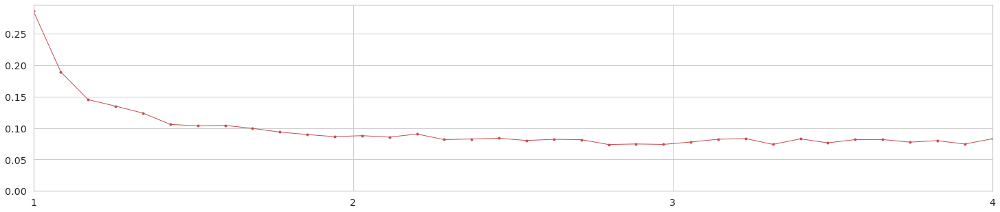

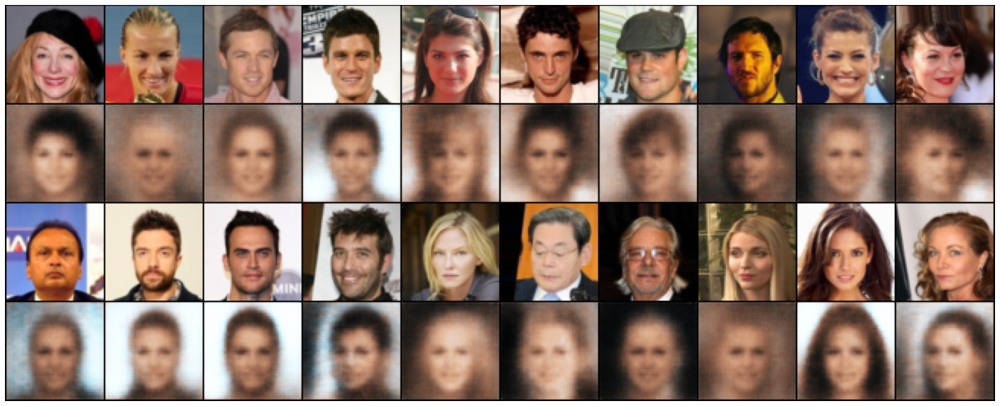

time: 20:15:27        epoch: 001/004        batch: 01582/01583        loss: 0.0896        
time: 20:19:30        epoch: 002/004        batch: 01582/01583        loss: 0.0919        
time: 20:23:32        epoch: 003/004        batch: 01582/01583        loss: 0.0770        
time: 20:27:34        epoch: 004/004        batch: 01582/01583        loss: 0.0914        
DCAE_effect_of_hyperparams_result_4606fbd0.json
n_code_dim                               16
n_channels                               3
relu_slope                               0.01
bias                                     False
n_encoder_feature_maps                   8
encoder_feature_map_multiplier           2
n_encoder_dense_layers                   2
encoder_dense_neurons_multiplier         4
encoder_dropout                          0.0
input_noise_p                            0.0
input_noise_std                          0.0
n_decoder_feature_maps                   8
decoder_feature_map_multiplier           2
n_decoder_dense

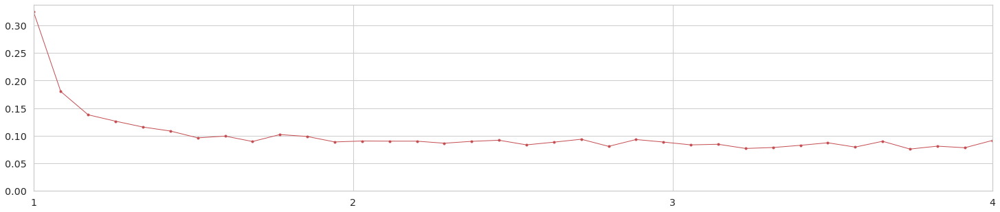

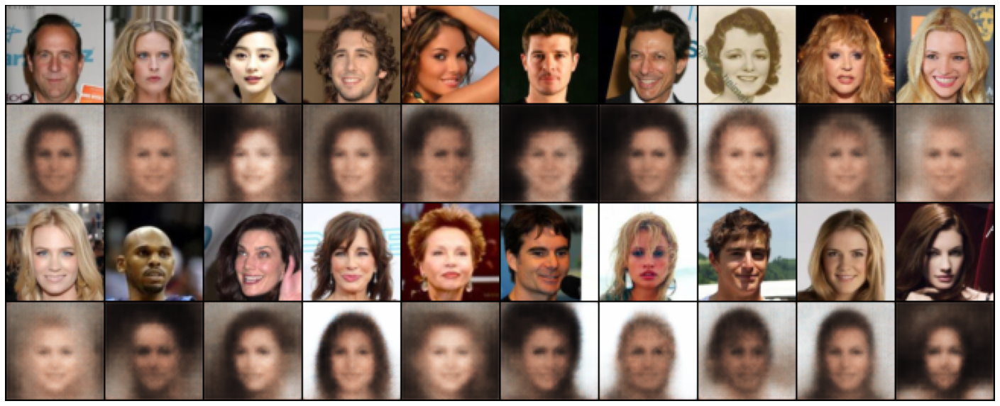

time: 20:33:01        epoch: 001/004        batch: 01582/01583        loss: 0.0801        
time: 20:38:27        epoch: 002/004        batch: 01582/01583        loss: 0.0706        
time: 20:43:53        epoch: 003/004        batch: 01582/01583        loss: 0.0685        
time: 20:49:21        epoch: 004/004        batch: 01582/01583        loss: 0.0786        
DCAE_effect_of_hyperparams_result_9b138150.json
n_code_dim                               16
n_channels                               3
relu_slope                               0.01
bias                                     False
n_encoder_feature_maps                   32
encoder_feature_map_multiplier           2
n_encoder_dense_layers                   0
encoder_dense_neurons_multiplier         4
encoder_dropout                          0.0
input_noise_p                            0.0
input_noise_std                          0.0
n_decoder_feature_maps                   32
decoder_feature_map_multiplier           2
n_decoder_den

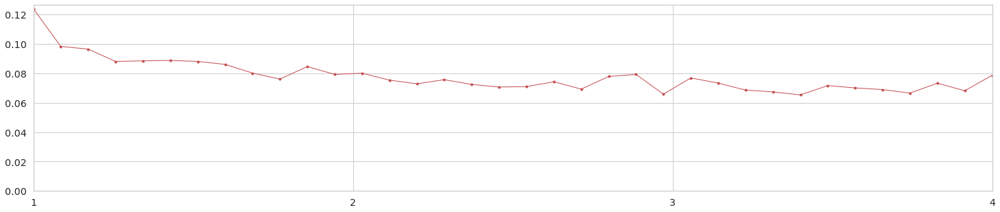

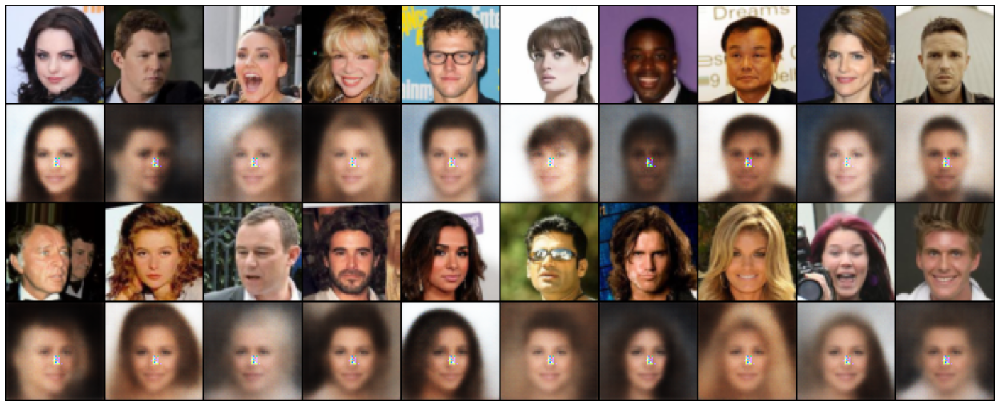

time: 20:54:53        epoch: 001/004        batch: 01582/01583        loss: 0.0832        
time: 21:00:25        epoch: 002/004        batch: 01582/01583        loss: 0.0716        
time: 21:05:57        epoch: 003/004        batch: 01582/01583        loss: 0.0733        
time: 21:11:28        epoch: 004/004        batch: 01582/01583        loss: 0.0667        
DCAE_effect_of_hyperparams_result_f2e54109.json
n_code_dim                               16
n_channels                               3
relu_slope                               0.01
bias                                     False
n_encoder_feature_maps                   32
encoder_feature_map_multiplier           2
n_encoder_dense_layers                   1
encoder_dense_neurons_multiplier         4
encoder_dropout                          0.0
input_noise_p                            0.0
input_noise_std                          0.0
n_decoder_feature_maps                   32
decoder_feature_map_multiplier           2
n_decoder_den

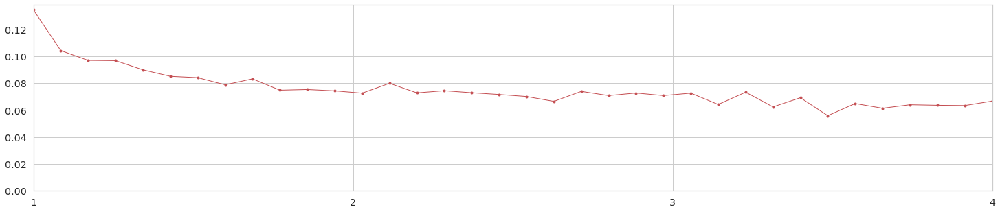

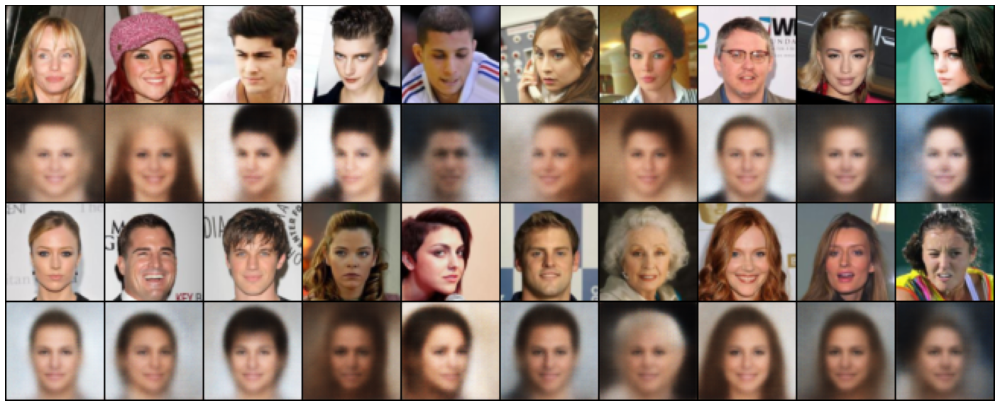

time: 21:17:05        epoch: 001/004        batch: 01582/01583        loss: 0.0966        
time: 21:22:41        epoch: 002/004        batch: 01582/01583        loss: 0.0822        
time: 21:28:18        epoch: 003/004        batch: 01582/01583        loss: 0.0806        
time: 21:33:54        epoch: 004/004        batch: 01582/01583        loss: 0.0734        
DCAE_effect_of_hyperparams_result_642725c3.json
n_code_dim                               16
n_channels                               3
relu_slope                               0.01
bias                                     False
n_encoder_feature_maps                   32
encoder_feature_map_multiplier           2
n_encoder_dense_layers                   2
encoder_dense_neurons_multiplier         4
encoder_dropout                          0.0
input_noise_p                            0.0
input_noise_std                          0.0
n_decoder_feature_maps                   32
decoder_feature_map_multiplier           2
n_decoder_den

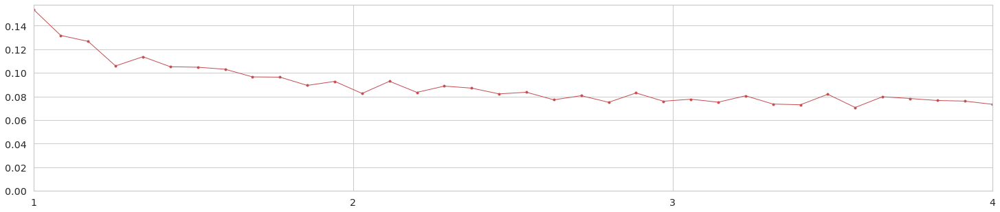

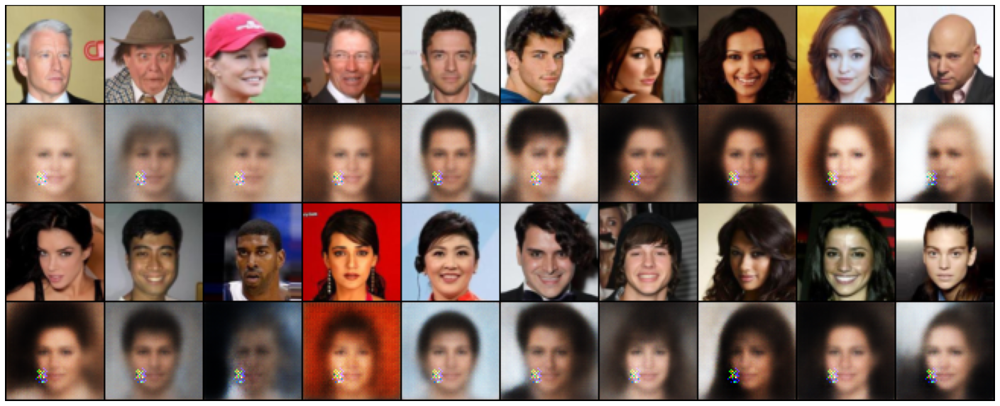

time: 21:49:43        epoch: 001/004        batch: 01582/01583        loss: 0.0796        
time: 22:05:31        epoch: 002/004        batch: 01582/01583        loss: 0.0765        
time: 22:21:19        epoch: 003/004        batch: 01582/01583        loss: 0.0768        
time: 22:37:15        epoch: 004/004        batch: 01582/01583        loss: 0.0662        
DCAE_effect_of_hyperparams_result_b061dcef.json
n_code_dim                               16
n_channels                               3
relu_slope                               0.01
bias                                     False
n_encoder_feature_maps                   128
encoder_feature_map_multiplier           2
n_encoder_dense_layers                   0
encoder_dense_neurons_multiplier         4
encoder_dropout                          0.0
input_noise_p                            0.0
input_noise_std                          0.0
n_decoder_feature_maps                   128
decoder_feature_map_multiplier           2
n_decoder_d

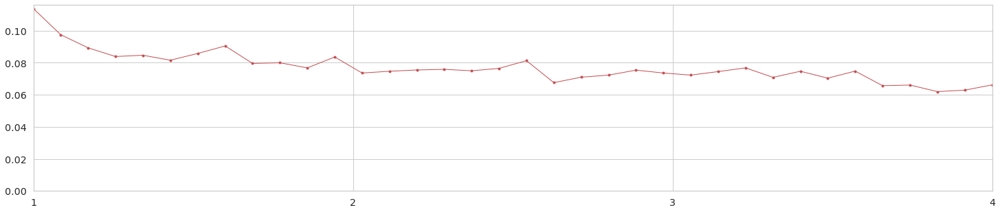

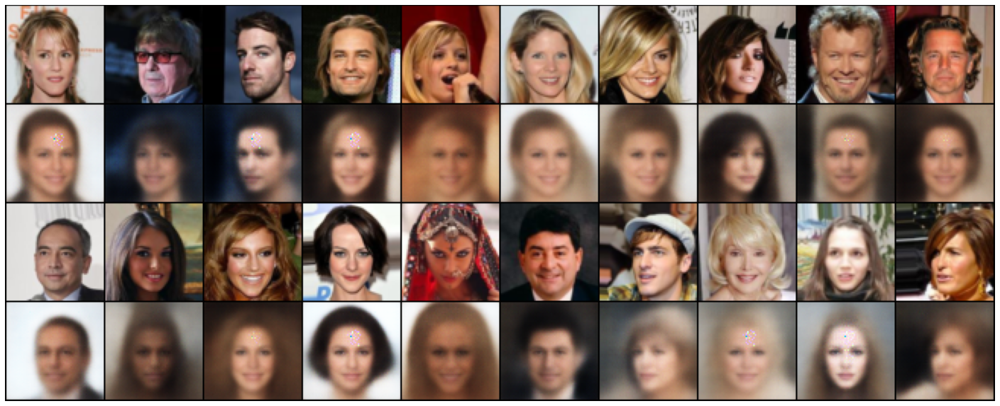

time: 22:53:34        epoch: 001/004        batch: 01582/01583        loss: 0.0845        
time: 23:09:49        epoch: 002/004        batch: 01582/01583        loss: 0.0783        
time: 23:26:03        epoch: 003/004        batch: 01582/01583        loss: 0.0722        
time: 23:42:17        epoch: 004/004        batch: 01582/01583        loss: 0.0643        
DCAE_effect_of_hyperparams_result_a38500f7.json
n_code_dim                               16
n_channels                               3
relu_slope                               0.01
bias                                     False
n_encoder_feature_maps                   128
encoder_feature_map_multiplier           2
n_encoder_dense_layers                   1
encoder_dense_neurons_multiplier         4
encoder_dropout                          0.0
input_noise_p                            0.0
input_noise_std                          0.0
n_decoder_feature_maps                   128
decoder_feature_map_multiplier           2
n_decoder_d

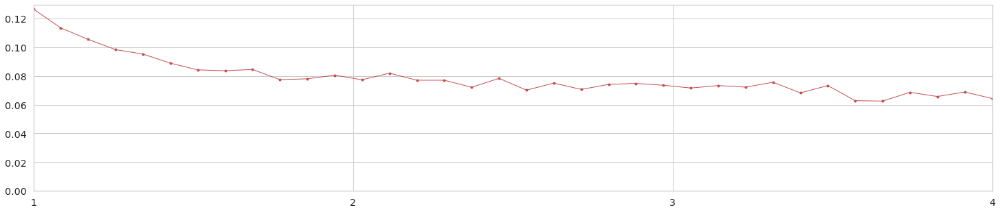

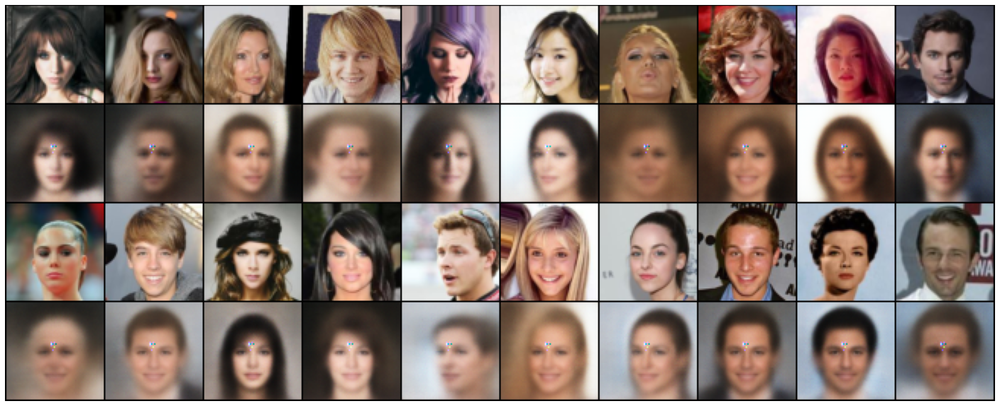

time: 23:58:38        epoch: 001/004        batch: 01582/01583        loss: 0.0845        
time: 00:15:00        epoch: 002/004        batch: 01582/01583        loss: 0.0736        
time: 00:31:20        epoch: 003/004        batch: 01582/01583        loss: 0.0630        
time: 00:47:39        epoch: 004/004        batch: 01582/01583        loss: 0.0721        
DCAE_effect_of_hyperparams_result_28db99e1.json
n_code_dim                               16
n_channels                               3
relu_slope                               0.01
bias                                     False
n_encoder_feature_maps                   128
encoder_feature_map_multiplier           2
n_encoder_dense_layers                   2
encoder_dense_neurons_multiplier         4
encoder_dropout                          0.0
input_noise_p                            0.0
input_noise_std                          0.0
n_decoder_feature_maps                   128
decoder_feature_map_multiplier           2
n_decoder_d

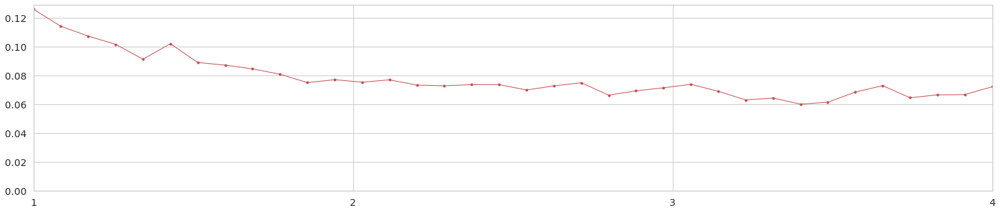

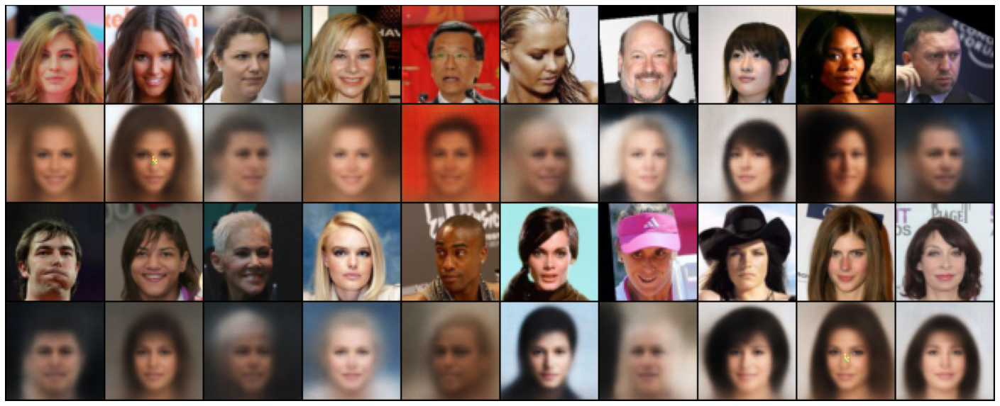

time: 00:51:34        epoch: 001/004        batch: 01582/01583        loss: 0.0658        
time: 00:55:28        epoch: 002/004        batch: 01582/01583        loss: 0.0569        
time: 00:59:22        epoch: 003/004        batch: 01582/01583        loss: 0.0496        
time: 01:03:15        epoch: 004/004        batch: 01582/01583        loss: 0.0482        
DCAE_effect_of_hyperparams_result_c6bd06b6.json
n_code_dim                               64
n_channels                               3
relu_slope                               0.01
bias                                     False
n_encoder_feature_maps                   8
encoder_feature_map_multiplier           2
n_encoder_dense_layers                   0
encoder_dense_neurons_multiplier         4
encoder_dropout                          0.0
input_noise_p                            0.0
input_noise_std                          0.0
n_decoder_feature_maps                   8
decoder_feature_map_multiplier           2
n_decoder_dense

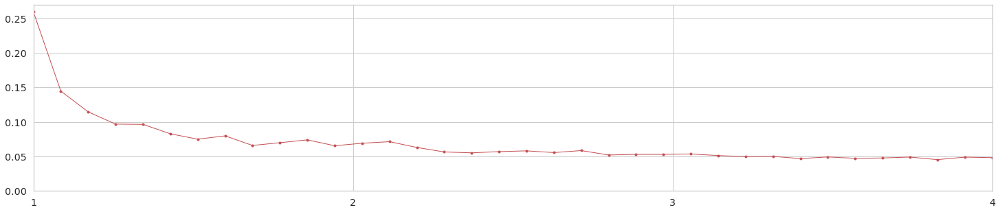

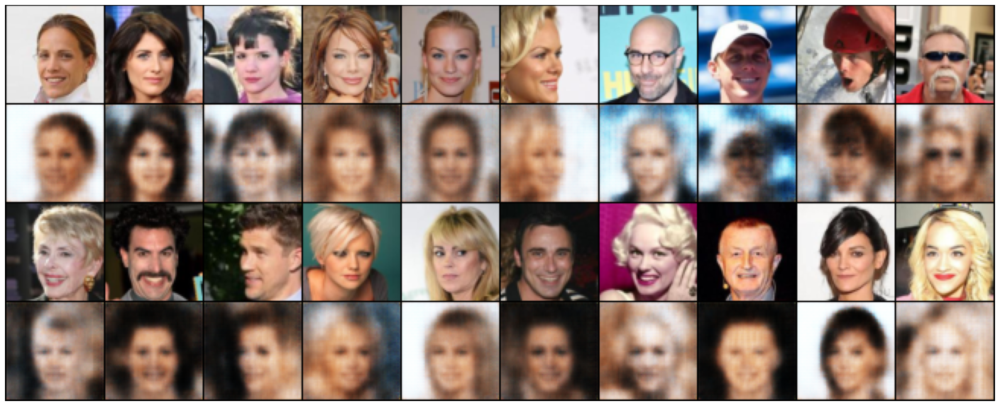

time: 01:07:18        epoch: 001/004        batch: 01582/01583        loss: 0.0674        
time: 01:11:20        epoch: 002/004        batch: 01582/01583        loss: 0.0585        
time: 01:15:22        epoch: 003/004        batch: 01582/01583        loss: 0.0493        
time: 01:19:24        epoch: 004/004        batch: 01582/01583        loss: 0.0487        
DCAE_effect_of_hyperparams_result_3f77d031.json
n_code_dim                               64
n_channels                               3
relu_slope                               0.01
bias                                     False
n_encoder_feature_maps                   8
encoder_feature_map_multiplier           2
n_encoder_dense_layers                   1
encoder_dense_neurons_multiplier         4
encoder_dropout                          0.0
input_noise_p                            0.0
input_noise_std                          0.0
n_decoder_feature_maps                   8
decoder_feature_map_multiplier           2
n_decoder_dense

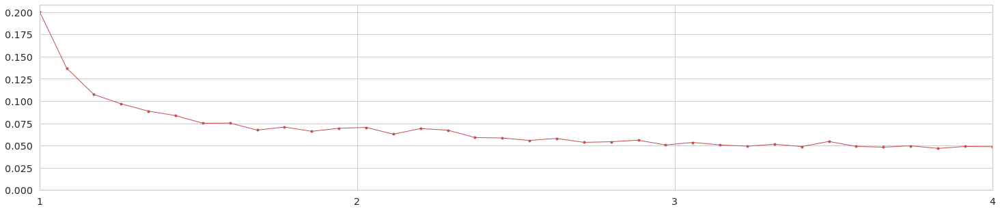

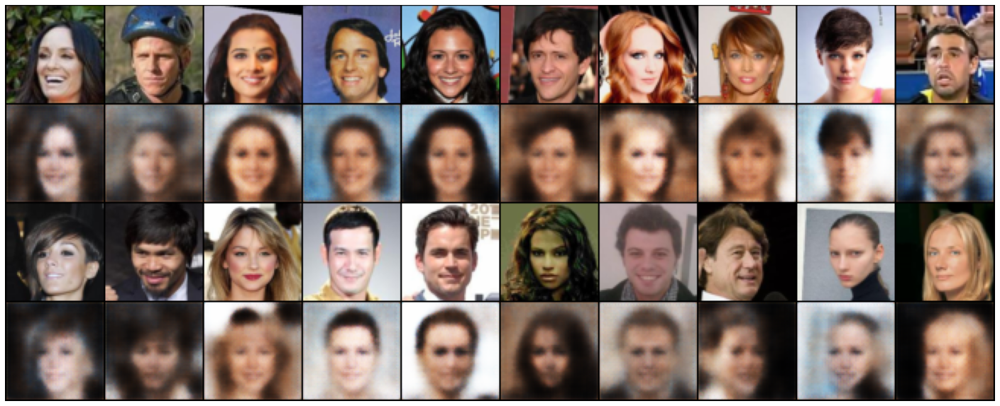

time: 01:23:32        epoch: 001/004        batch: 01582/01583        loss: 0.0930        
time: 01:27:39        epoch: 002/004        batch: 01582/01583        loss: 0.0708        
time: 01:31:46        epoch: 003/004        batch: 01582/01583        loss: 0.0616        
time: 01:35:52        epoch: 004/004        batch: 01582/01583        loss: 0.0542        
DCAE_effect_of_hyperparams_result_a35052ea.json
n_code_dim                               64
n_channels                               3
relu_slope                               0.01
bias                                     False
n_encoder_feature_maps                   8
encoder_feature_map_multiplier           2
n_encoder_dense_layers                   2
encoder_dense_neurons_multiplier         4
encoder_dropout                          0.0
input_noise_p                            0.0
input_noise_std                          0.0
n_decoder_feature_maps                   8
decoder_feature_map_multiplier           2
n_decoder_dense

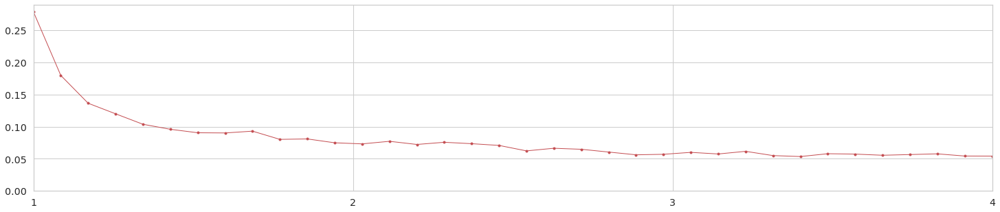

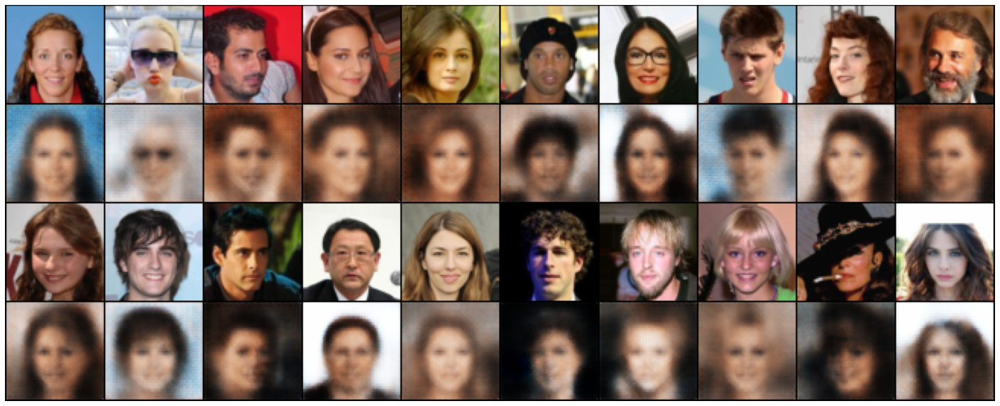

time: 01:41:19        epoch: 001/004        batch: 01582/01583        loss: 0.0564        
time: 01:46:46        epoch: 002/004        batch: 01582/01583        loss: 0.0428        
time: 01:52:13        epoch: 003/004        batch: 01582/01583        loss: 0.0458        
time: 01:57:39        epoch: 004/004        batch: 01582/01583        loss: 0.0421        
DCAE_effect_of_hyperparams_result_71ed6b0d.json
n_code_dim                               64
n_channels                               3
relu_slope                               0.01
bias                                     False
n_encoder_feature_maps                   32
encoder_feature_map_multiplier           2
n_encoder_dense_layers                   0
encoder_dense_neurons_multiplier         4
encoder_dropout                          0.0
input_noise_p                            0.0
input_noise_std                          0.0
n_decoder_feature_maps                   32
decoder_feature_map_multiplier           2
n_decoder_den

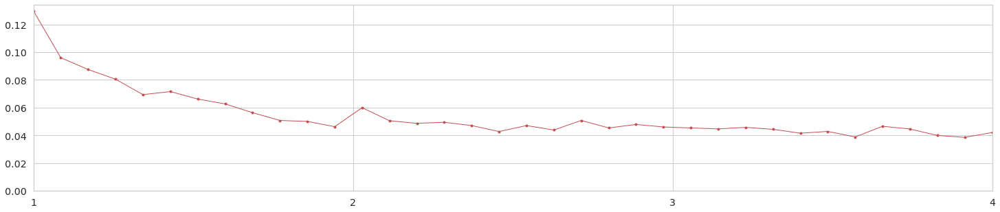

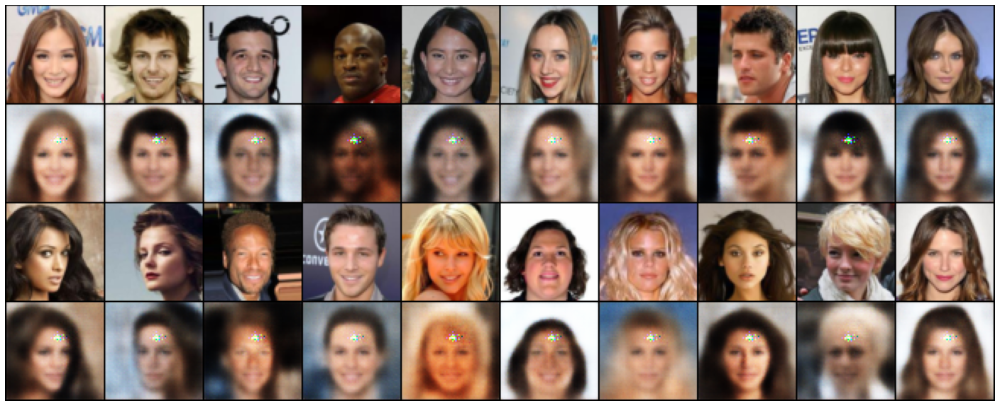

time: 02:03:15        epoch: 001/004        batch: 01582/01583        loss: 0.0547        
time: 02:08:50        epoch: 002/004        batch: 01582/01583        loss: 0.0432        
time: 02:14:25        epoch: 003/004        batch: 01582/01583        loss: 0.0430        
time: 02:20:00        epoch: 004/004        batch: 01582/01583        loss: 0.0374        
DCAE_effect_of_hyperparams_result_77a067e2.json
n_code_dim                               64
n_channels                               3
relu_slope                               0.01
bias                                     False
n_encoder_feature_maps                   32
encoder_feature_map_multiplier           2
n_encoder_dense_layers                   1
encoder_dense_neurons_multiplier         4
encoder_dropout                          0.0
input_noise_p                            0.0
input_noise_std                          0.0
n_decoder_feature_maps                   32
decoder_feature_map_multiplier           2
n_decoder_den

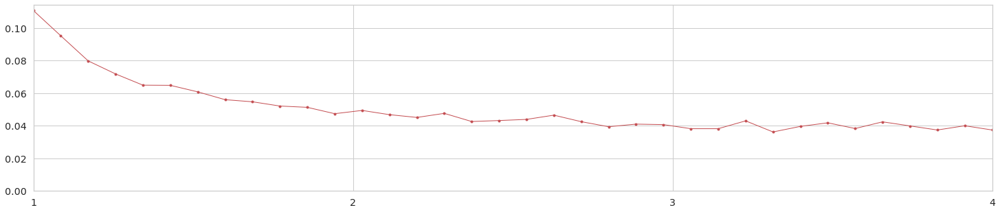

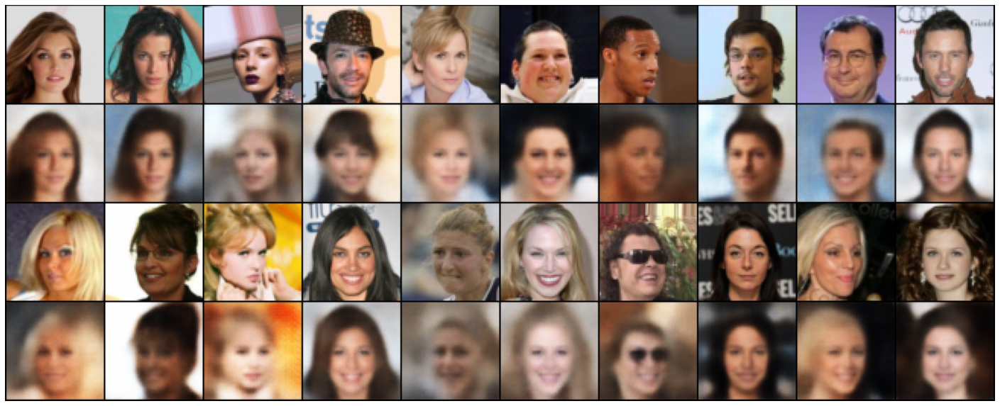

time: 02:25:41        epoch: 001/004        batch: 01582/01583        loss: 0.0609        
time: 02:31:21        epoch: 002/004        batch: 01582/01583        loss: 0.0500        
time: 02:37:01        epoch: 003/004        batch: 01582/01583        loss: 0.0468        
time: 02:42:41        epoch: 004/004        batch: 01582/01583        loss: 0.0392        
DCAE_effect_of_hyperparams_result_5cea2bc0.json
n_code_dim                               64
n_channels                               3
relu_slope                               0.01
bias                                     False
n_encoder_feature_maps                   32
encoder_feature_map_multiplier           2
n_encoder_dense_layers                   2
encoder_dense_neurons_multiplier         4
encoder_dropout                          0.0
input_noise_p                            0.0
input_noise_std                          0.0
n_decoder_feature_maps                   32
decoder_feature_map_multiplier           2
n_decoder_den

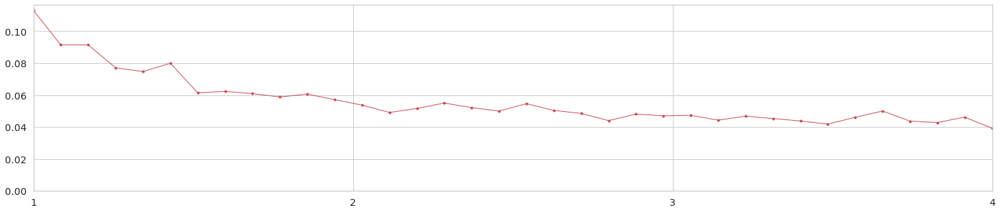

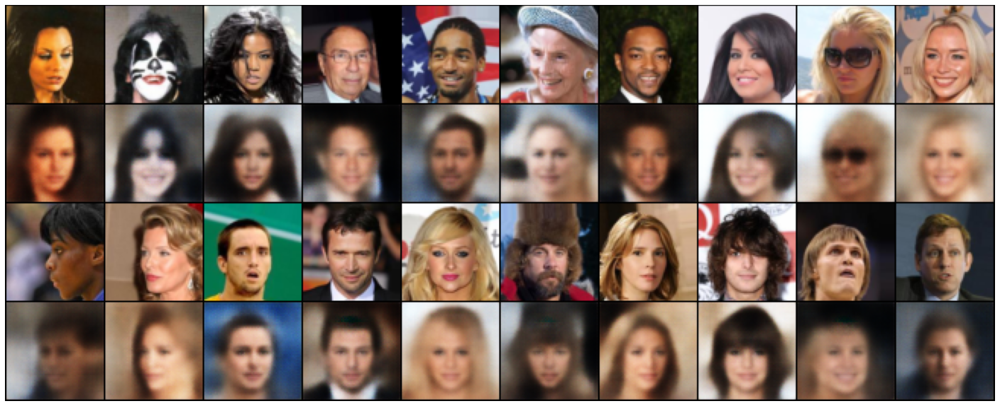

time: 02:58:37        epoch: 001/004        batch: 01582/01583        loss: 0.0411        
time: 03:14:33        epoch: 002/004        batch: 01582/01583        loss: 0.0365        
time: 03:30:29        epoch: 003/004        batch: 01582/01583        loss: 0.0373        
time: 03:46:26        epoch: 004/004        batch: 01582/01583        loss: 0.0349        
DCAE_effect_of_hyperparams_result_37d7c3e1.json
n_code_dim                               64
n_channels                               3
relu_slope                               0.01
bias                                     False
n_encoder_feature_maps                   128
encoder_feature_map_multiplier           2
n_encoder_dense_layers                   0
encoder_dense_neurons_multiplier         4
encoder_dropout                          0.0
input_noise_p                            0.0
input_noise_std                          0.0
n_decoder_feature_maps                   128
decoder_feature_map_multiplier           2
n_decoder_d

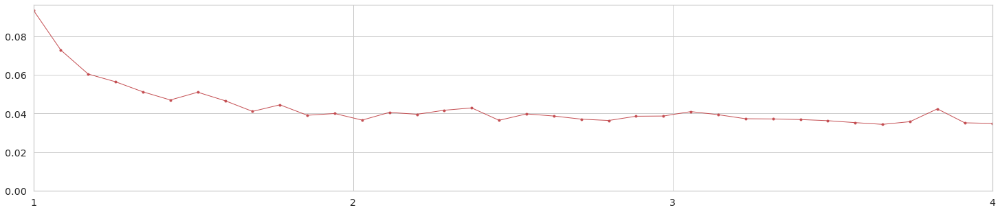

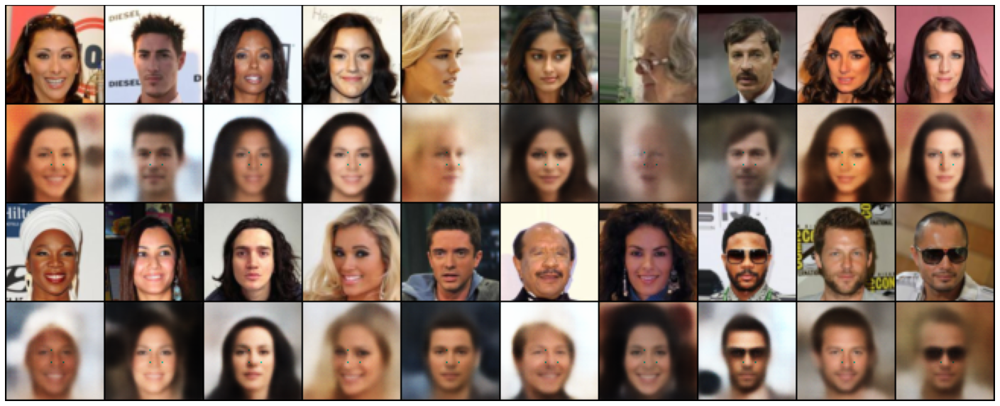

time: 04:03:10        epoch: 001/004        batch: 01582/01583        loss: 0.0497        
time: 04:19:53        epoch: 002/004        batch: 01582/01583        loss: 0.0416        
time: 04:36:36        epoch: 003/004        batch: 01582/01583        loss: 0.0400        
time: 04:53:19        epoch: 004/004        batch: 01582/01583        loss: 0.0386        
DCAE_effect_of_hyperparams_result_240cad0e.json
n_code_dim                               64
n_channels                               3
relu_slope                               0.01
bias                                     False
n_encoder_feature_maps                   128
encoder_feature_map_multiplier           2
n_encoder_dense_layers                   1
encoder_dense_neurons_multiplier         4
encoder_dropout                          0.0
input_noise_p                            0.0
input_noise_std                          0.0
n_decoder_feature_maps                   128
decoder_feature_map_multiplier           2
n_decoder_d

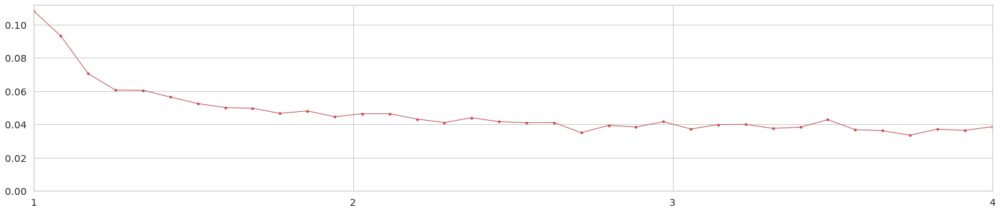

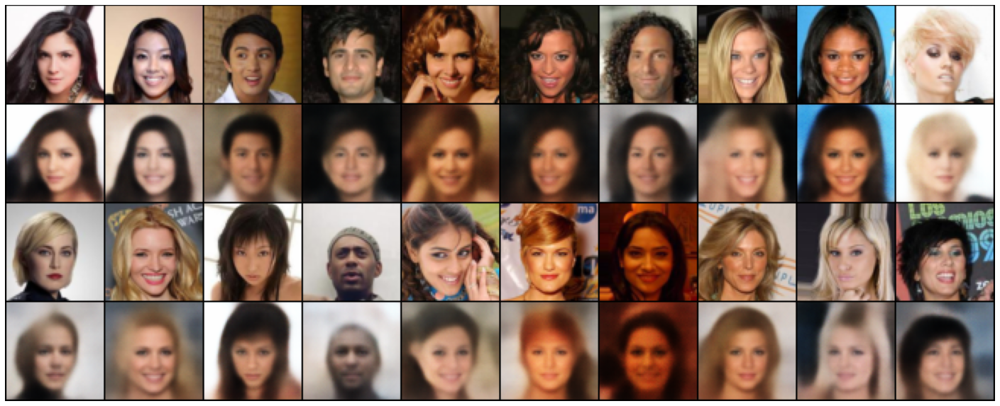

time: 05:09:25        epoch: 001/004        batch: 01582/01583        loss: 0.0558        


In [ ]:
for n_code_dim in [16, 64, 256]:
    for n_feature_maps in [8, 32, 128]:
        for n_dense_layers in [0, 1, 2]:
            model = AutoEncoder(n_code_dim=n_code_dim,
                                n_encoder_feature_maps=n_feature_maps,
                                n_decoder_feature_maps=n_feature_maps,
                                encoder_feature_map_multiplier=2,
                                decoder_feature_map_multiplier=2,
                                n_decoder_dense_layers=n_dense_layers,
                                n_encoder_dense_layers=n_dense_layers,
                                encoder_dense_neurons_multiplier=4,
                                decoder_dense_neurons_multiplier=4
            ).to(device)
            evaluate_model(model)
print('done')

skip
skip
skip
skip
skip
skip
skip
skip
skip
skip
skip
skip
skip
skip
skip
skip
skip
time: 08:05:55        epoch: 001/004        batch: 01582/01583        loss: 0.0561        
time: 08:22:38        epoch: 002/004        batch: 01582/01583        loss: 0.0450        
time: 08:39:22        epoch: 003/004        batch: 01582/01583        loss: 0.0447        
time: 08:56:08        epoch: 004/004        batch: 01582/01583        loss: 0.0381        
DCAE_effect_of_hyperparams_result_96b0aea9.json
n_code_dim                               64
n_channels                               3
relu_slope                               0.01
bias                                     False
n_encoder_feature_maps                   128
encoder_feature_map_multiplier           2
n_encoder_dense_layers                   2
encoder_dense_neurons_multiplier         4
encoder_dropout                          0.0
input_noise_p                            0.0
input_noise_std                          0.0
n_decoder_feat

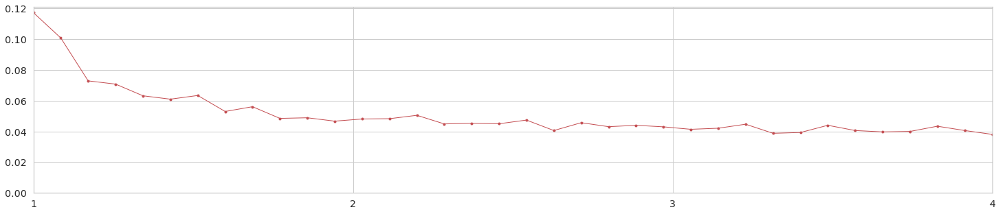

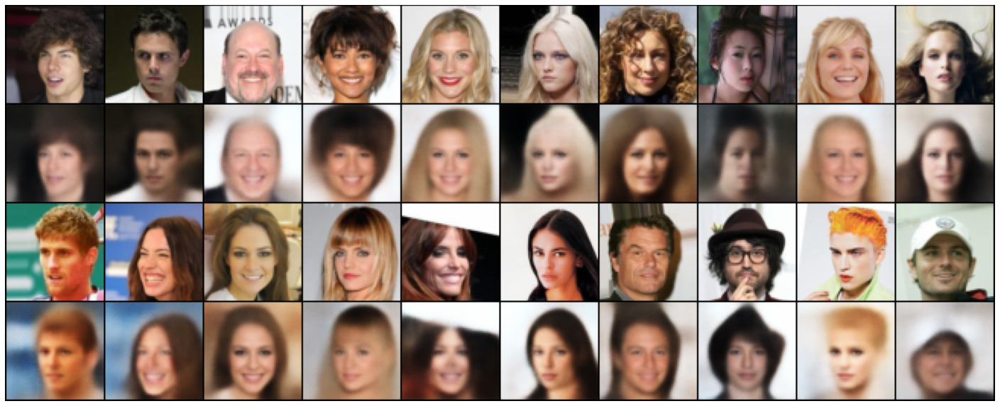

time: 09:00:06        epoch: 001/004        batch: 01582/01583        loss: 0.0575        
time: 09:04:00        epoch: 002/004        batch: 01582/01583        loss: 0.0454        
time: 09:07:55        epoch: 003/004        batch: 01582/01583        loss: 0.0389        
time: 09:11:50        epoch: 004/004        batch: 01582/01583        loss: 0.0341        
DCAE_effect_of_hyperparams_result_abd2d6b2.json
n_code_dim                               256
n_channels                               3
relu_slope                               0.01
bias                                     False
n_encoder_feature_maps                   8
encoder_feature_map_multiplier           2
n_encoder_dense_layers                   0
encoder_dense_neurons_multiplier         4
encoder_dropout                          0.0
input_noise_p                            0.0
input_noise_std                          0.0
n_decoder_feature_maps                   8
decoder_feature_map_multiplier           2
n_decoder_dens

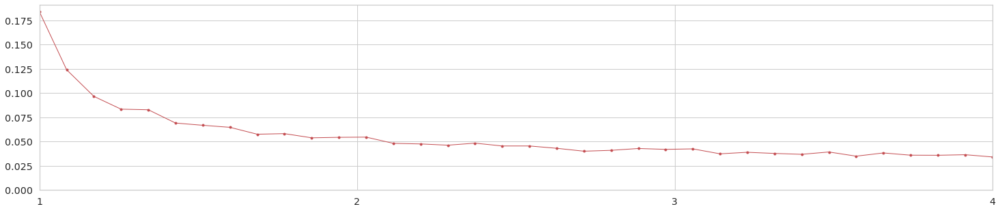

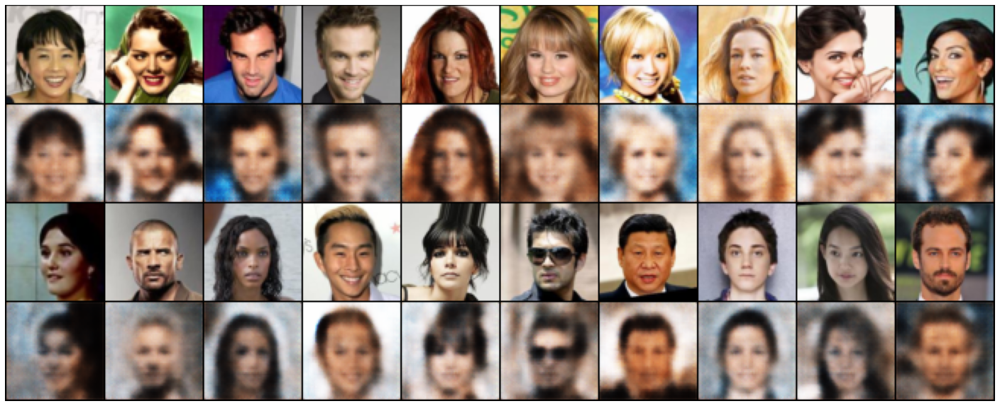

time: 09:16:08        epoch: 001/004        batch: 01582/01583        loss: 0.0653        
time: 09:20:24        epoch: 002/004        batch: 01582/01583        loss: 0.0442        
time: 09:24:42        epoch: 003/004        batch: 01582/01583        loss: 0.0403        
time: 09:29:00        epoch: 004/004        batch: 01582/01583        loss: 0.0366        
DCAE_effect_of_hyperparams_result_8c1a31d8.json
n_code_dim                               256
n_channels                               3
relu_slope                               0.01
bias                                     False
n_encoder_feature_maps                   8
encoder_feature_map_multiplier           2
n_encoder_dense_layers                   1
encoder_dense_neurons_multiplier         4
encoder_dropout                          0.0
input_noise_p                            0.0
input_noise_std                          0.0
n_decoder_feature_maps                   8
decoder_feature_map_multiplier           2
n_decoder_dens

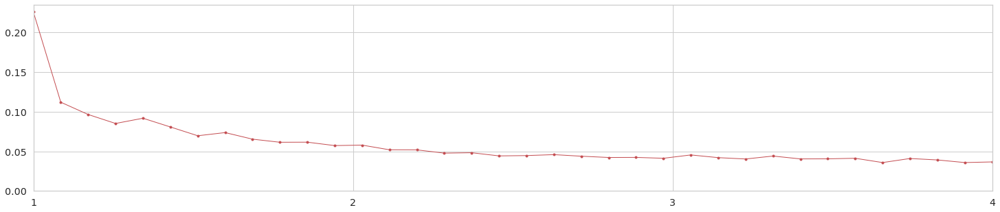

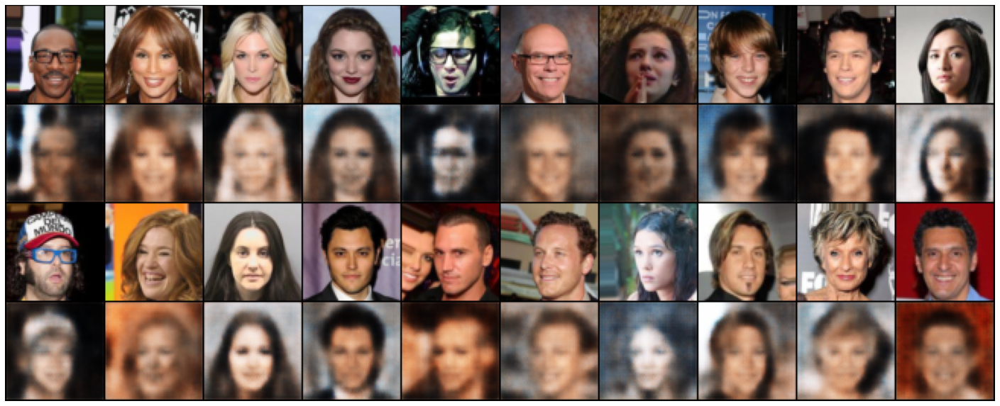

time: 09:33:25        epoch: 001/004        batch: 01582/01583        loss: 0.0872        
time: 09:37:50        epoch: 002/004        batch: 01582/01583        loss: 0.0566        
time: 09:42:15        epoch: 003/004        batch: 01582/01583        loss: 0.0508        
time: 09:46:39        epoch: 004/004        batch: 01582/01583        loss: 0.0485        
DCAE_effect_of_hyperparams_result_d3ef0f61.json
n_code_dim                               256
n_channels                               3
relu_slope                               0.01
bias                                     False
n_encoder_feature_maps                   8
encoder_feature_map_multiplier           2
n_encoder_dense_layers                   2
encoder_dense_neurons_multiplier         4
encoder_dropout                          0.0
input_noise_p                            0.0
input_noise_std                          0.0
n_decoder_feature_maps                   8
decoder_feature_map_multiplier           2
n_decoder_dens

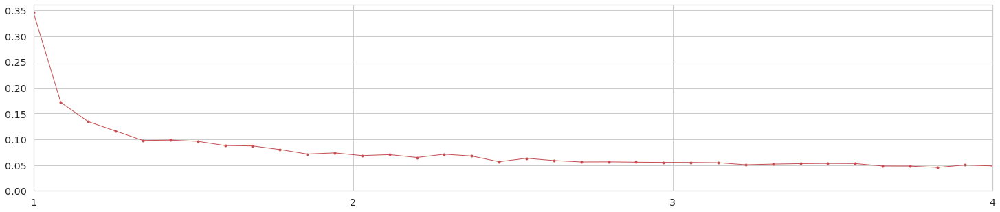

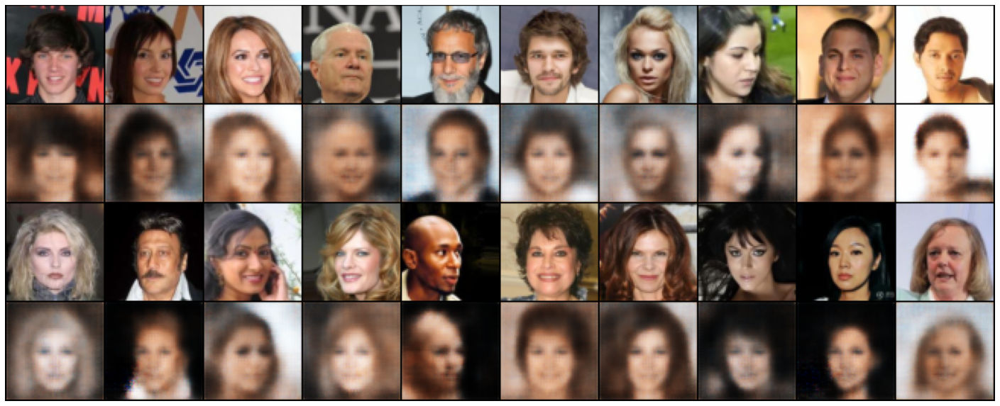

time: 09:52:09        epoch: 001/004        batch: 01582/01583        loss: 0.0433        
time: 09:57:38        epoch: 002/004        batch: 01582/01583        loss: 0.0333        
time: 10:03:07        epoch: 003/004        batch: 01582/01583        loss: 0.0269        
time: 10:08:37        epoch: 004/004        batch: 01582/01583        loss: 0.0234        
DCAE_effect_of_hyperparams_result_bffae591.json
n_code_dim                               256
n_channels                               3
relu_slope                               0.01
bias                                     False
n_encoder_feature_maps                   32
encoder_feature_map_multiplier           2
n_encoder_dense_layers                   0
encoder_dense_neurons_multiplier         4
encoder_dropout                          0.0
input_noise_p                            0.0
input_noise_std                          0.0
n_decoder_feature_maps                   32
decoder_feature_map_multiplier           2
n_decoder_de

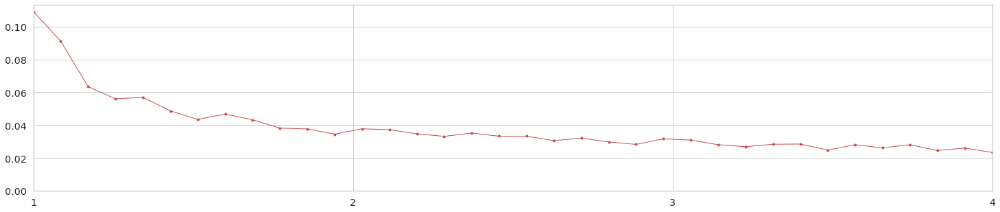

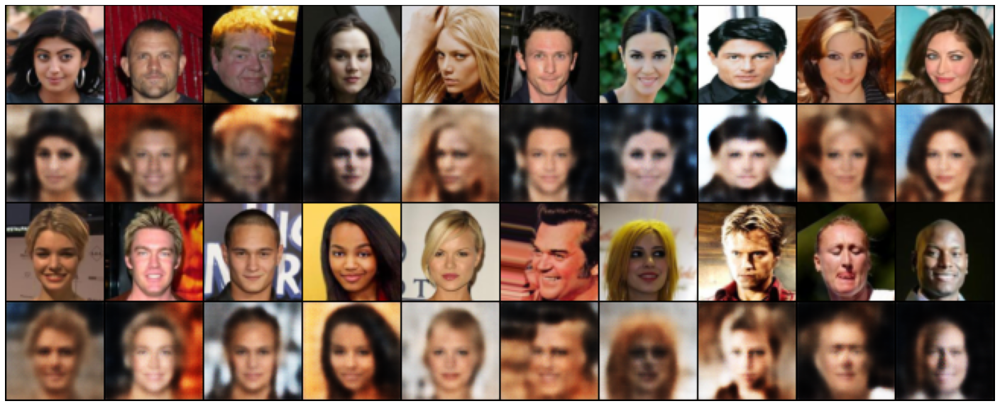

time: 10:14:26        epoch: 001/004        batch: 01582/01583        loss: 0.0448        
time: 10:20:14        epoch: 002/004        batch: 01582/01583        loss: 0.0381        
time: 10:26:03        epoch: 003/004        batch: 01582/01583        loss: 0.0313        
time: 10:31:52        epoch: 004/004        batch: 01582/01583        loss: 0.0268        
DCAE_effect_of_hyperparams_result_f07f0da1.json
n_code_dim                               256
n_channels                               3
relu_slope                               0.01
bias                                     False
n_encoder_feature_maps                   32
encoder_feature_map_multiplier           2
n_encoder_dense_layers                   1
encoder_dense_neurons_multiplier         4
encoder_dropout                          0.0
input_noise_p                            0.0
input_noise_std                          0.0
n_decoder_feature_maps                   32
decoder_feature_map_multiplier           2
n_decoder_de

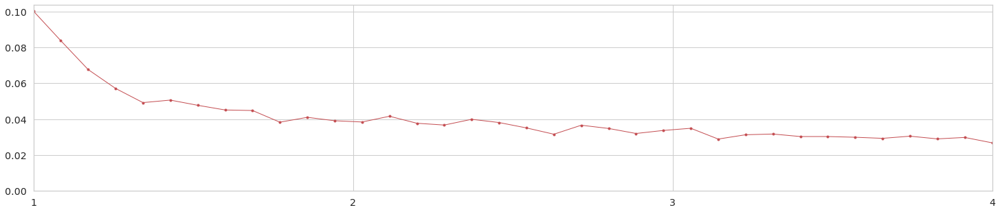

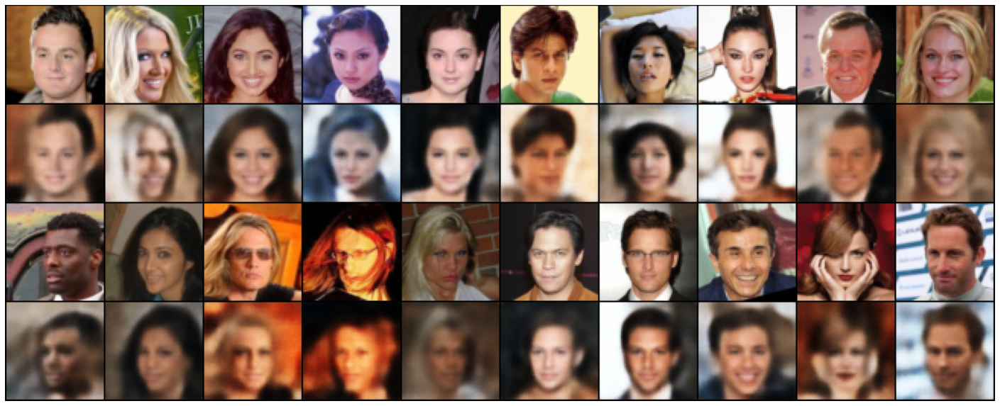

time: 10:37:47        epoch: 001/004        batch: 01582/01583        loss: 0.0490        
time: 10:43:42        epoch: 002/004        batch: 01582/01583        loss: 0.0472        
time: 10:49:36        epoch: 003/004        batch: 01582/01583        loss: 0.0389        
time: 10:55:31        epoch: 004/004        batch: 01582/01583        loss: 0.0338        
DCAE_effect_of_hyperparams_result_9afcd950.json
n_code_dim                               256
n_channels                               3
relu_slope                               0.01
bias                                     False
n_encoder_feature_maps                   32
encoder_feature_map_multiplier           2
n_encoder_dense_layers                   2
encoder_dense_neurons_multiplier         4
encoder_dropout                          0.0
input_noise_p                            0.0
input_noise_std                          0.0
n_decoder_feature_maps                   32
decoder_feature_map_multiplier           2
n_decoder_de

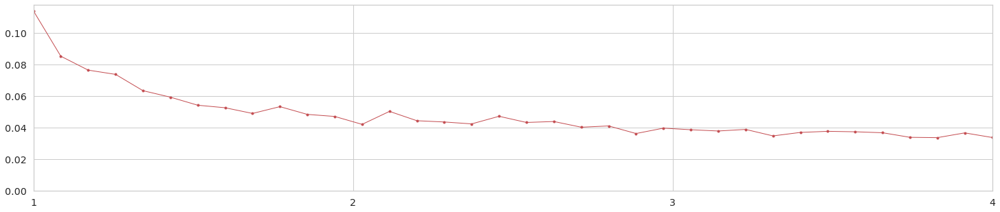

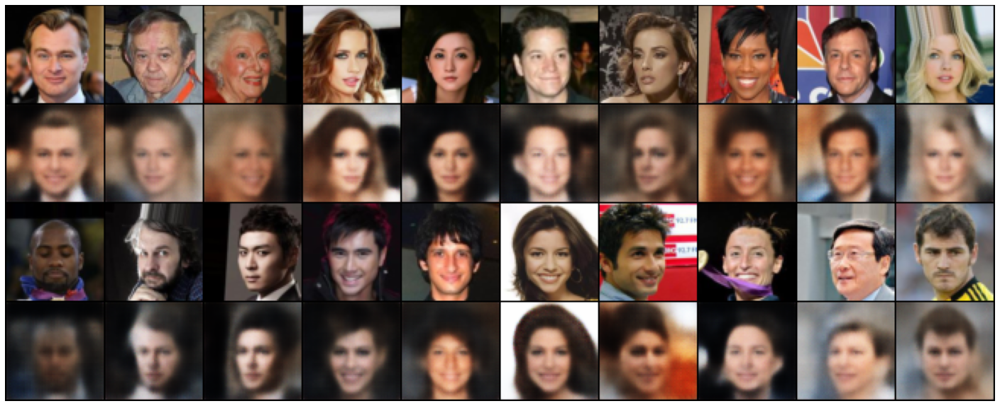

time: 11:12:01        epoch: 001/004        batch: 01582/01583        loss: 0.0397        
time: 11:28:33        epoch: 002/004        batch: 01582/01583        loss: 0.0280        
time: 11:45:04        epoch: 003/004        batch: 01582/01583        loss: 0.0257        
time: 12:01:34        epoch: 004/004        batch: 01582/01583        loss: 0.0216        
DCAE_effect_of_hyperparams_result_efc72488.json
n_code_dim                               256
n_channels                               3
relu_slope                               0.01
bias                                     False
n_encoder_feature_maps                   128
encoder_feature_map_multiplier           2
n_encoder_dense_layers                   0
encoder_dense_neurons_multiplier         4
encoder_dropout                          0.0
input_noise_p                            0.0
input_noise_std                          0.0
n_decoder_feature_maps                   128
decoder_feature_map_multiplier           2
n_decoder_

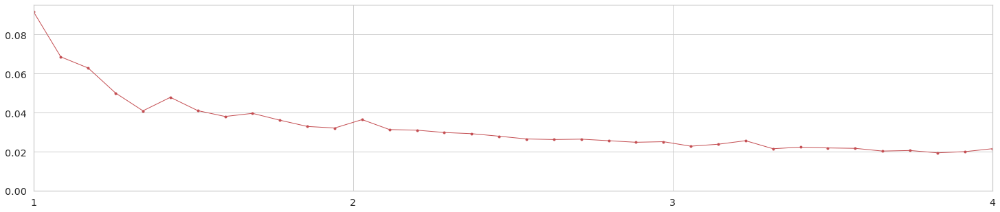

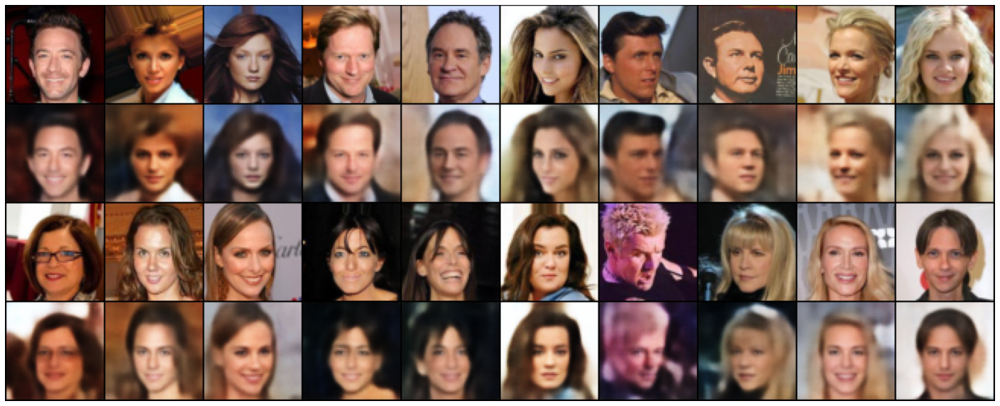

time: 12:20:38        epoch: 001/004        batch: 01582/01583        loss: 0.0373        
time: 12:39:42        epoch: 002/004        batch: 01582/01583        loss: 0.0308        
time: 12:58:46        epoch: 003/004        batch: 01582/01583        loss: 0.0279        
time: 13:17:49        epoch: 004/004        batch: 01582/01583        loss: 0.0247        
DCAE_effect_of_hyperparams_result_047f32b2.json
n_code_dim                               256
n_channels                               3
relu_slope                               0.01
bias                                     False
n_encoder_feature_maps                   128
encoder_feature_map_multiplier           2
n_encoder_dense_layers                   1
encoder_dense_neurons_multiplier         4
encoder_dropout                          0.0
input_noise_p                            0.0
input_noise_std                          0.0
n_decoder_feature_maps                   128
decoder_feature_map_multiplier           2
n_decoder_

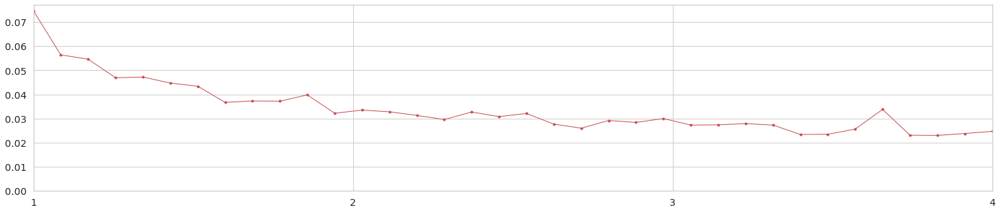

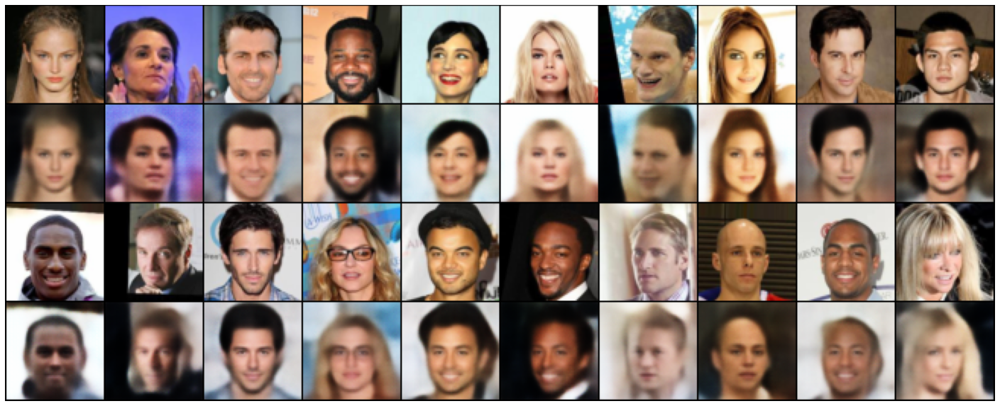

time: 13:36:49        epoch: 001/004        batch: 01582/01583        loss: 0.0465        
time: 13:55:49        epoch: 002/004        batch: 01582/01583        loss: 0.0379        
time: 14:14:45        epoch: 003/004        batch: 01582/01583        loss: 0.0398        
time: 14:33:44        epoch: 004/004        batch: 01582/01583        loss: 0.0353        
DCAE_effect_of_hyperparams_result_b47abf59.json
n_code_dim                               256
n_channels                               3
relu_slope                               0.01
bias                                     False
n_encoder_feature_maps                   128
encoder_feature_map_multiplier           2
n_encoder_dense_layers                   2
encoder_dense_neurons_multiplier         4
encoder_dropout                          0.0
input_noise_p                            0.0
input_noise_std                          0.0
n_decoder_feature_maps                   128
decoder_feature_map_multiplier           2
n_decoder_

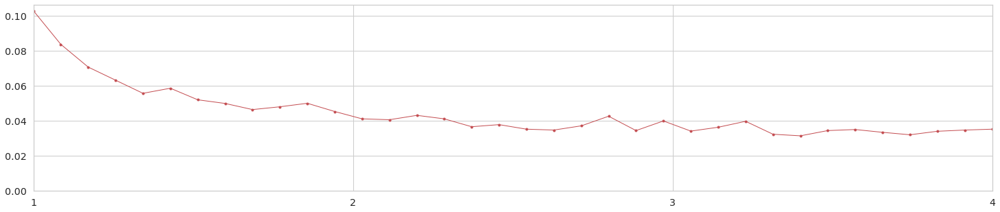

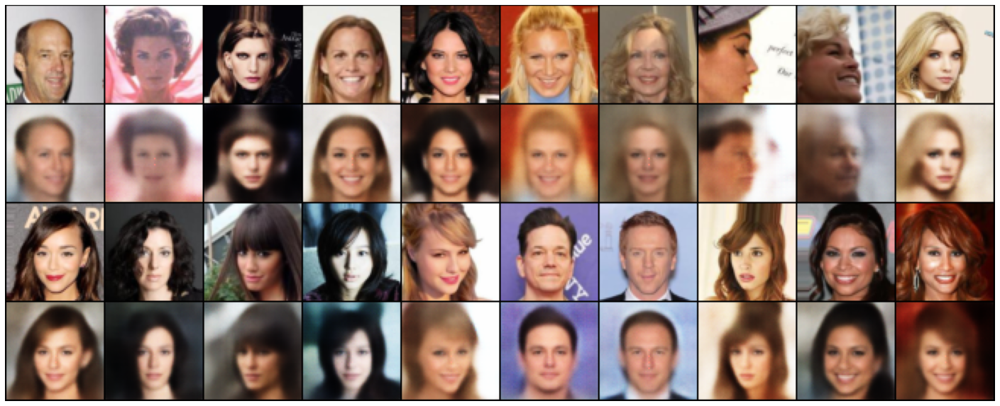

done


In [8]:
i = 0
for n_code_dim in [16, 64, 256]:
    for n_feature_maps in [8, 32, 128]:
        for n_dense_layers in [0, 1, 2]:
            i += 1
            if i < 18:
                print('skip')
                continue
            model = AutoEncoder(n_code_dim=n_code_dim,
                                n_encoder_feature_maps=n_feature_maps,
                                n_decoder_feature_maps=n_feature_maps,
                                encoder_feature_map_multiplier=2,
                                decoder_feature_map_multiplier=2,
                                n_decoder_dense_layers=n_dense_layers,
                                n_encoder_dense_layers=n_dense_layers,
                                encoder_dense_neurons_multiplier=4,
                                decoder_dense_neurons_multiplier=4
            ).to(device)
            evaluate_model(model)
print('done')

time: 17:12:39        epoch: 001/004        batch: 01582/01583        loss: 0.0573        
time: 17:17:27        epoch: 002/004        batch: 01582/01583        loss: 0.0420        
time: 17:22:15        epoch: 003/004        batch: 01582/01583        loss: 0.0425        
time: 17:27:04        epoch: 004/004        batch: 01582/01583        loss: 0.0343        
DCAE_effect_of_hyperparams_result_55bd60e4.json
n_code_dim                               256
n_channels                               3
relu_slope                               0.01
bias                                     False
n_encoder_feature_maps                   32
encoder_feature_map_multiplier           1
n_encoder_dense_layers                   0
encoder_dense_neurons_multiplier         4
encoder_dropout                          0.0
input_noise_p                            0.0
input_noise_std                          0.0
n_decoder_feature_maps                   32
decoder_feature_map_multiplier           1
n_decoder_de

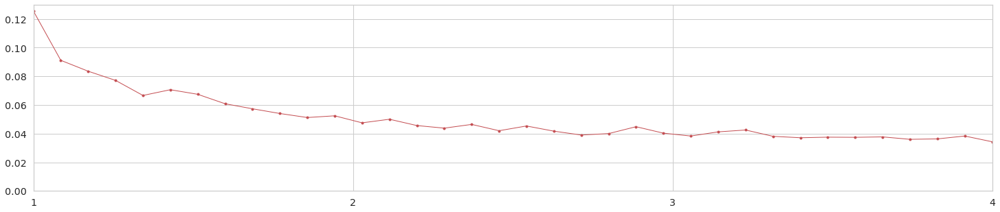

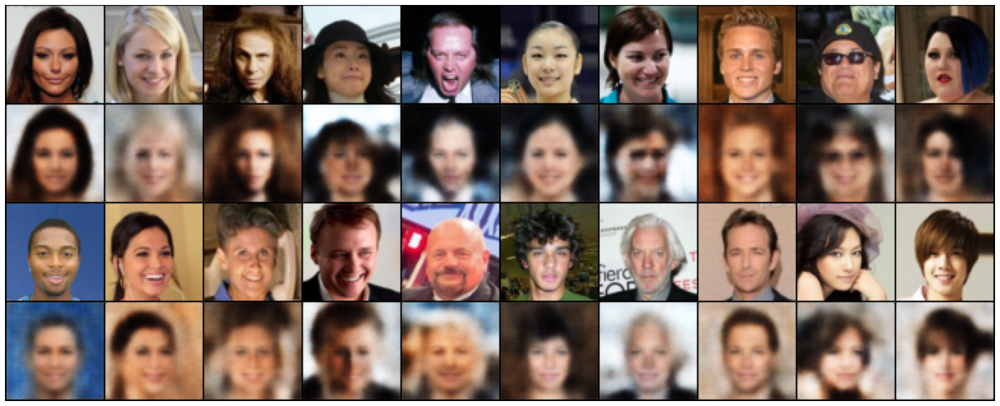

time: 17:35:07        epoch: 001/004        batch: 01582/01583        loss: 0.0408        
time: 17:43:10        epoch: 002/004        batch: 01582/01583        loss: 0.0314        
time: 17:51:14        epoch: 003/004        batch: 01582/01583        loss: 0.0259        
time: 17:59:18        epoch: 004/004        batch: 01582/01583        loss: 0.0234        
DCAE_effect_of_hyperparams_result_2701554a.json
n_code_dim                               256
n_channels                               3
relu_slope                               0.01
bias                                     False
n_encoder_feature_maps                   32
encoder_feature_map_multiplier           3
n_encoder_dense_layers                   0
encoder_dense_neurons_multiplier         4
encoder_dropout                          0.0
input_noise_p                            0.0
input_noise_std                          0.0
n_decoder_feature_maps                   32
decoder_feature_map_multiplier           3
n_decoder_de

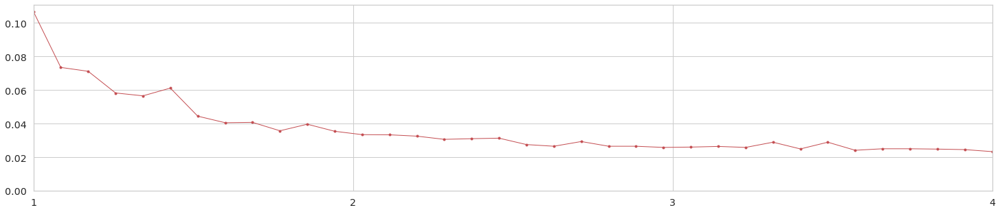

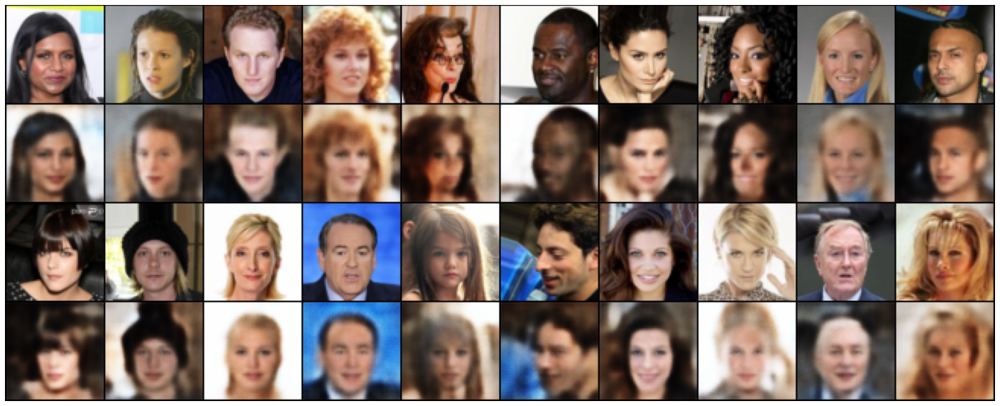

done


In [104]:
i = 0
for feature_map_multiplier in [1, 3]:
    model = AutoEncoder(n_code_dim=256,
                        n_encoder_feature_maps=32,
                        n_decoder_feature_maps=32,
                        encoder_feature_map_multiplier=feature_map_multiplier,
                        decoder_feature_map_multiplier=feature_map_multiplier,
                        n_decoder_dense_layers=0,
                        n_encoder_dense_layers=0,
                        encoder_dense_neurons_multiplier=4,
                        decoder_dense_neurons_multiplier=4
    ).to(device)
    evaluate_model(model)
print('done')

time: 18:11:44        epoch: 001/004        batch: 01582/01583        loss: 0.0874        
time: 18:17:23        epoch: 002/004        batch: 01582/01583        loss: 0.0715        
time: 18:23:03        epoch: 003/004        batch: 01582/01583        loss: 0.0742        
time: 18:28:43        epoch: 004/004        batch: 01582/01583        loss: 0.0748        
DCAE_effect_of_hyperparams_result_36f79151.json
n_code_dim                               256
n_channels                               3
relu_slope                               0.01
bias                                     False
n_encoder_feature_maps                   32
encoder_feature_map_multiplier           2
n_encoder_dense_layers                   0
encoder_dense_neurons_multiplier         4
encoder_dropout                          0.1
input_noise_p                            0.0
input_noise_std                          0.0
n_decoder_feature_maps                   32
decoder_feature_map_multiplier           2
n_decoder_de

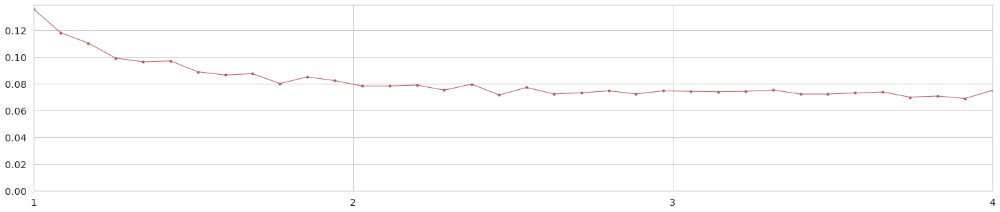

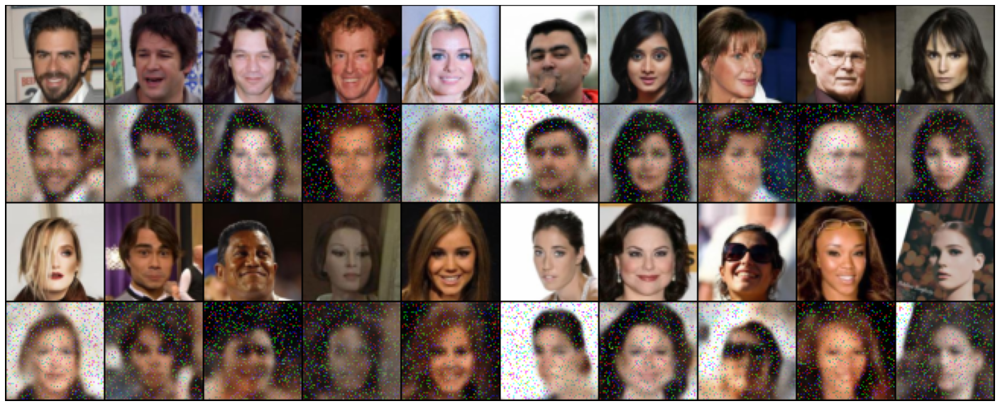

time: 18:34:22        epoch: 001/004        batch: 01582/01583        loss: 0.1252        
time: 18:40:01        epoch: 002/004        batch: 01582/01583        loss: 0.1117        
time: 18:45:39        epoch: 003/004        batch: 01582/01583        loss: 0.1195        
time: 18:51:20        epoch: 004/004        batch: 01582/01583        loss: 0.1100        
DCAE_effect_of_hyperparams_result_31c4fdb0.json
n_code_dim                               256
n_channels                               3
relu_slope                               0.01
bias                                     False
n_encoder_feature_maps                   32
encoder_feature_map_multiplier           2
n_encoder_dense_layers                   0
encoder_dense_neurons_multiplier         4
encoder_dropout                          0.2
input_noise_p                            0.0
input_noise_std                          0.0
n_decoder_feature_maps                   32
decoder_feature_map_multiplier           2
n_decoder_de

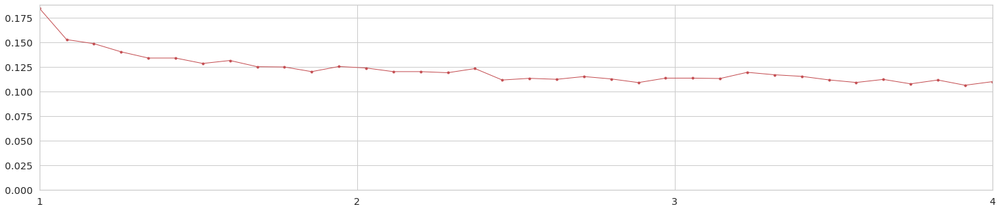

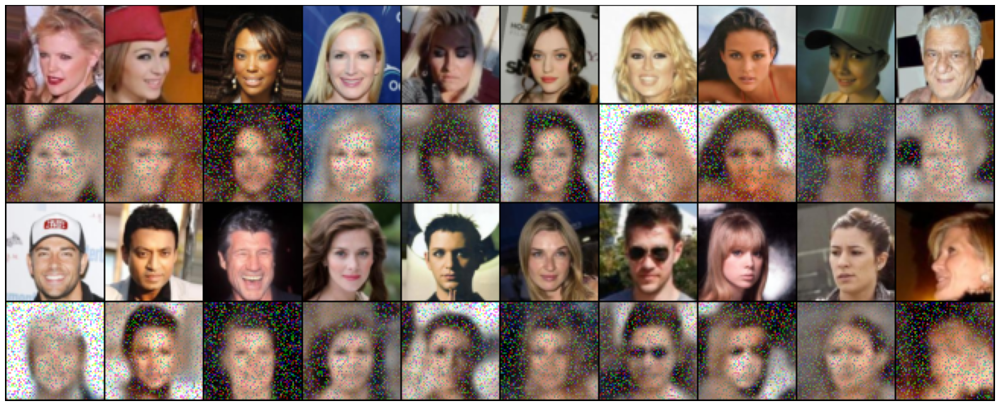

time: 18:57:01        epoch: 001/004        batch: 01582/01583        loss: 0.2344        
time: 19:02:40        epoch: 002/004        batch: 01582/01583        loss: 0.2337        
time: 19:08:21        epoch: 003/004        batch: 01582/01583        loss: 0.2247        
time: 19:13:59        epoch: 004/004        batch: 01582/01583        loss: 0.2168        
DCAE_effect_of_hyperparams_result_1fd51c1a.json
n_code_dim                               256
n_channels                               3
relu_slope                               0.01
bias                                     False
n_encoder_feature_maps                   32
encoder_feature_map_multiplier           2
n_encoder_dense_layers                   0
encoder_dense_neurons_multiplier         4
encoder_dropout                          0.5
input_noise_p                            0.0
input_noise_std                          0.0
n_decoder_feature_maps                   32
decoder_feature_map_multiplier           2
n_decoder_de

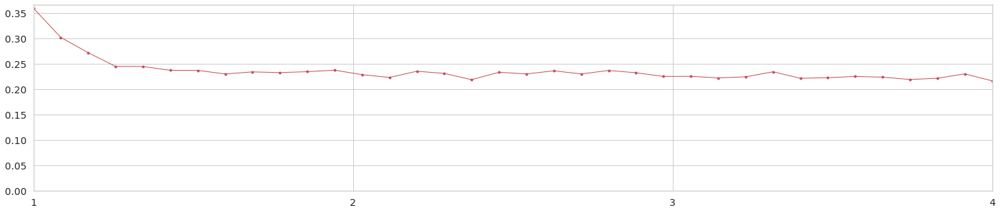

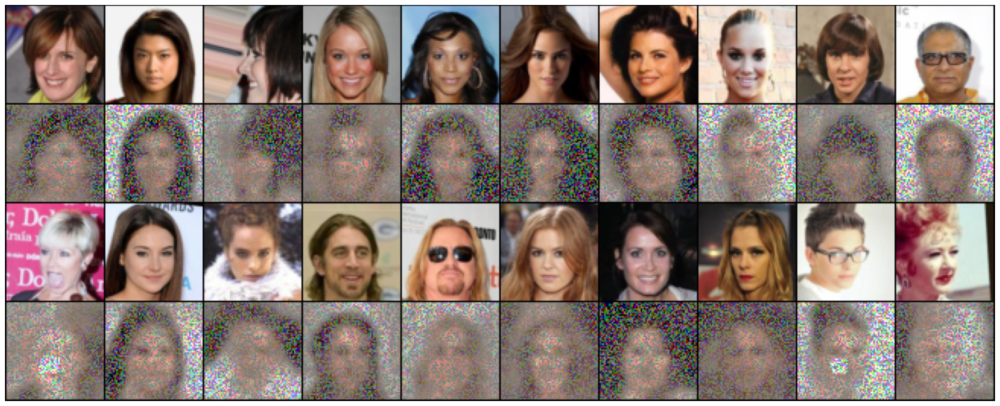

done


In [106]:
i = 0
for dropout in [0.1, 0.2, 0.5]:
    model = AutoEncoder(n_code_dim=256,
                        n_encoder_feature_maps=32,
                        n_decoder_feature_maps=32,
                        encoder_feature_map_multiplier=2,
                        decoder_feature_map_multiplier=2,
                        n_decoder_dense_layers=0,
                        n_encoder_dense_layers=0,
                        encoder_dense_neurons_multiplier=4,
                        decoder_dense_neurons_multiplier=4,
                        encoder_dropout=dropout,
                        decoder_dropout=dropout
    ).to(device)
    evaluate_model(model)
print('done')

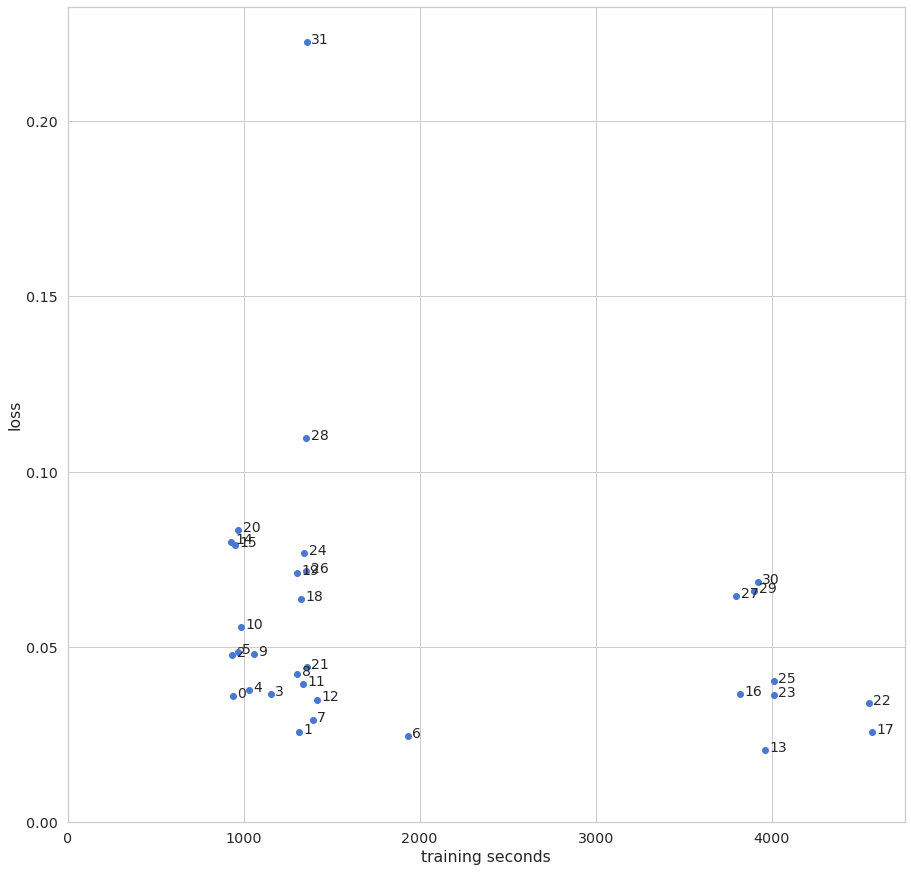

Loss order
    code_dim  n_f_maps  f_map_mul  n_d_layer  dropout     loss  time  time_rank  loss_rank  comb_rank
13       256       128          2          0 0.000000 0.020500  3962         28          1         29
6        256        32          3          0 0.000000 0.024600  1932         23          2         25
1        256        32          2          0 0.000000 0.025700  1316         13          3         16
17       256       128          2          1 0.000000 0.025700  4573         32          3         35
7        256        32          2          1 0.000000 0.029100  1393         21          5         26
22       256       128          2          2 0.000000 0.034000  4552         31          6         37
12       256        32          2          2 0.000000 0.035000  1418         22          7         29
0        256         8          2          0 0.000000 0.036100   940          3          8         11
23        64       128          2          1 0.000000 0.036400  4011   

In [108]:
performances = []
for file_name in glob.glob('DCAE_effect_of_hyperparams_result_*.json'):
    with open(file_name) as f:
        performances.append(json.loads(f.read()))
performances = pd.DataFrame(performances)[[
    'n_code_dim',
    'n_encoder_feature_maps',
    'encoder_feature_map_multiplier',
    'n_encoder_dense_layers',
    'encoder_dropout',
    'recent_loss',
    'training_time']]
performances.columns = [
    'code_dim',
    'n_f_maps',
    'f_map_mul',
    'n_d_layer',
    'dropout',
    'loss',
    'time']
performances['time_rank'] = performances.time.rank().astype(int)
performances['loss_rank'] = performances.loss.rank().astype(int)
performances['comb_rank'] = performances['time_rank'] + performances['loss_rank']
performances.sort_values(by=['comb_rank'], inplace=True)
performances.index = range(len(performances))

fig, ax = plt.subplots(figsize=(15, 15))
plt.scatter(
    performances.time,
    performances.loss)

def dict_to_str(e):
    l = []
    for k in e.keys():
        l.append(f'{k:10}{e[k]}')
    return '\n'.join(l)

annotations = [dict_to_str(e) for e in performances.to_dict(orient='records')]

for i in range(len(performances)):
    ax.annotate(
        str(i),
        (performances.time.tolist()[i] + 25, performances.loss.tolist()[i] - 0.00045),
        fontsize=14)

plt.xlim((0, None))
plt.ylim((0, None))
plt.xlabel('training seconds')
plt.ylabel('loss')
plt.show()

print('Loss order')
print(performances.sort_values(by=['loss_rank']))
print()

print('Time order')
print(performances.sort_values(by=['time_rank']))
print()

print('Combined order')
print(performances.sort_values(by=['comb_rank']))

In [109]:
pd.DataFrame(performances).to_csv('DCAE_effect_of_hyperparams.csv')